# Multiclass Mental Health Status and Cyber bullying Detection from Social Media


In [4]:
# !pip install kaggle
import pandas as pd
import warnings
warnings.filterwarnings('ignore', category=pd.errors.SettingWithCopyWarning)

### Verifying GPU Access

In [5]:
import torch

print("CUDA available:", torch.cuda.is_available())
if torch.cuda.is_available():
    print("GPU name:", torch.cuda.get_device_name(0))
else:
    print("No GPU detected.")


CUDA available: True
GPU name: Tesla V100-SXM2-32GB


## FOR LOCAL ENVIRONMENT SETUP - Use the code below instead of Kaggle secrets

In [3]:
# For local environment setup - you need to set up Kaggle API credentials
# 1. Go to https://www.kaggle.com/account and create an API token
# 2. Download the kaggle.json file
# 3. Place it in ~/.kaggle/kaggle.json
# 4. Set proper permissions: chmod 600 ~/.kaggle/kaggle.json

import os
import subprocess

# Check if kaggle is available
try:
    import kaggle
    print("Kaggle API is available")
except ImportError:
    print("Kaggle API not found. Please install with: pip install kaggle")
    
# Set up Kaggle credentials if kaggle.json exists
kaggle_path = os.path.expanduser("~/.kaggle/kaggle.json")
if os.path.exists(kaggle_path):
    print("Kaggle credentials found")
else:
    print("Please set up Kaggle credentials as described above")

Kaggle API is available
Kaggle credentials found


### Twitter Depression dataset
The dataset is unlabelled (Actually it is categorized but you need to maybe add the labels if you are combining the datasets)

The data is not labelled but it is categorized into depression and non-depression datasets

In [5]:
!kaggle datasets download -d hyunkic/twitter-depression-dataset --unzip -p ./twitter_depression

Dataset URL: https://www.kaggle.com/datasets/hyunkic/twitter-depression-dataset
License(s): unknown
twitter-depression-dataset.zip: Skipping, found more recently modified local copy (use --force to force download)


The data imprted above is depression datasets

In [6]:
# Viewing the data
path = "./twitter_depression/"

The mental status column is empty so I added the status as depressed(labelling as discussed above). There are cleaned and uncleaned versions of the data

In [7]:
# Checking the data to avoid repeating posts from same user
check_clean_dep_df =  pd.read_csv(path + 'clean_non_d_tweets.csv')
check_clean_dep_df.head()
print(f"Total number of users: {check_clean_dep_df['id'].nunique() }")
print(f"Length of the whole dataset: {len(check_clean_dep_df)}")

if check_clean_dep_df['id'].nunique() == len(check_clean_dep_df):
    print("No duplicate users found.")
else:
    print('Duplicate users found, please clean the dataset.')

Total number of users: 4687
Length of the whole dataset: 4687
No duplicate users found.


In [8]:
# Cleaned Twitter Depression Data
clean_dep_df = pd.read_csv(path + 'clean_non_d_tweets.csv')
clean_dep_df['status'] = 'depression'
clean_dep_df_use = clean_dep_df[['tweet', 'status']]
clean_dep_df_use.rename(columns= {'tweet': 'text'}, inplace = True)
# print(clean_dep_df_use.head(4))
print("========================================================")
print(f"Shape of clean_dep_df_use: {clean_dep_df_use.shape}")

Shape of clean_dep_df_use: (4687, 2)


In [9]:
cp_clean_dep_df = clean_dep_df_use.copy()

# Ensure 'text' is a string
cp_clean_dep_df['text'] = cp_clean_dep_df['text'].astype(str)

# Calculate text length (e.g., number of characters)
cp_clean_dep_df['text_length'] = cp_clean_dep_df['text'].apply(len)
cp_clean_dep_df['word_count'] = cp_clean_dep_df['text'].apply(lambda x: len(x.split()))

# Calculate the average text length (use .mean(), not apply(mean))
avg_char_length = cp_clean_dep_df['text_length'].mean()
avg_word_length = cp_clean_dep_df['word_count'].mean()

# Print the result (no need to wrap avg_length in curly braces unless using f-string variables)
print(f"Average character Length of Twitter Depression post: {avg_char_length:.2f} characters")
print(f"Average word Length of Twitter Depression post: {avg_word_length:.2f} words")


Average character Length of Twitter Depression post: 94.56 characters
Average word Length of Twitter Depression post: 18.74 words


In [10]:
# Checking the data to avoid repeating posts from same user
check_clean_non_d_tweets_df = pd.read_csv(path + 'clean_non_d_tweets.csv')
check_clean_non_d_tweets_df.head()
print(f"Total number of users: {check_clean_non_d_tweets_df['id'].nunique() }")
print(f"Length of the whole dataset: {len(check_clean_non_d_tweets_df)}")

if check_clean_non_d_tweets_df['id'].nunique() == len(check_clean_non_d_tweets_df):
    print("No duplicate users found.")
else:
    print('Duplicate users found, please clean the dataset.')

Total number of users: 4687
Length of the whole dataset: 4687
No duplicate users found.


In [11]:
# Cleaned Twitter Non-Depression Data
clean_non_d_tweets_df = pd.read_csv(path + 'clean_non_d_tweets.csv')
clean_non_d_tweets_df.head(4)
clean_non_d_tweets_df['status'] = 'not_depression'
clean_non_dep_df_use = clean_non_d_tweets_df[['tweet', 'status']]
clean_non_dep_df_use.rename(columns= {'tweet': 'text'}, inplace = True)
# print(clean_non_dep_df_use.head(4))
print("========================================================")
print(f"Shape of clean_non_dep_df_use: {clean_non_dep_df_use.shape}")

Shape of clean_non_dep_df_use: (4687, 2)


## Reddit Suicide dataset

### Paper – [*Suicide Ideation Detection in Social Media Forums*](https://ieeexplore.ieee.org/document/9591887)

### Dataset Description from the Kaggle Authors below - However (The V13 used here only contains suicidal and non-suicidal datasets)
The dataset is a collection of posts from the "SuicideWatch" and "depression" subreddits of the Reddit platform. The posts are collected using Pushshift API. All posts that were made to "SuicideWatch" from Dec 16, 2008(creation) till Jan 2, 2021, were collected while "depression" posts were collected from Jan 1, 2009, to Jan 2, 2021. All posts collected from SuicideWatch are labeled as suicide, While posts collected from the depression subreddit are labeled as depression. Non-suicide posts are collected from r/teenagers.

In [12]:
#!/bin/bash
!kaggle datasets download nikhileswarkomati/suicide-watch --unzip -p ./suicide-watch --force

Dataset URL: https://www.kaggle.com/datasets/nikhileswarkomati/suicide-watch
License(s): CC-BY-SA-4.0
  0%|                                               | 0.00/60.6M [00:00<?, ?B/s]
100%|███████████████████████████████████████| 60.6M/60.6M [00:00<00:00, 884MB/s]


In [13]:
# # Checking the data to avoid repeating posts from same user
# check_suicide_df = pd.read_csv("./suicide-watch/Suicide_Detection.csv")
# check_suicide_df.head()
# print(f"Total number of users: {check_suicide_df['Unnamed: 0'].nunique() }")
# print(f"Length of the whole dataset: {len(check_suicide_df)}")

# if check_suicide_df['Unnamed: 0'].nunique() == len(check_suicide_df):
#     print("No duplicate users found.")
# else:
#     print('Duplicate users found, please clean the dataset.')

In [14]:
# Suicide Data
suicide_df = pd.read_csv("./suicide-watch/Suicide_Detection.csv")
suicide_df = suicide_df.drop(columns = ['Unnamed: 0'])
suicide_df.rename(columns = {'class': 'status'}, inplace = True)
# print(suicide_df.head(4))
print("========================================================")
print(f"Shape of suicide_df: {suicide_df.shape}")
# print(suicide_df['status'].unique())

Shape of suicide_df: (232074, 2)


In [15]:
import os
# os.environ.get('KAGGLE_KEY')

In [16]:
# Checking the Categories
print(suicide_df['status'].value_counts())

status
suicide        116037
non-suicide    116037
Name: count, dtype: int64


In [17]:
# Make a proper copy of the DataFrame (add parentheses)
cp_suicide_df = suicide_df.copy()

# Ensure 'text' is a string
cp_suicide_df['text'] = cp_suicide_df['text'].astype(str)
cp_suicide_df['text_length'] = cp_suicide_df['text'].apply(len)
cp_suicide_df['word_count'] = cp_suicide_df['text'].apply(lambda x: len(x.split()))
s_avg_char_length = cp_suicide_df['text_length'].mean()
s_avg_word_length = cp_suicide_df['word_count'].mean()
print(f"Average char Length of Reddit Depression post: {s_avg_char_length:.2f} characters")
print(f"Average word Length of Reddit Depression post: {s_avg_word_length:.2f} words")


Average char Length of Reddit Depression post: 689.64 characters
Average word Length of Reddit Depression post: 131.93 words


In [18]:
# suicide_df.iloc[90]

## Cyberbullying Dataset

This dataset contains more than 47000 tweets labelled according to the class of cyberbullying:

Age;
Ethnicity;
Gender;
Religion;
Other type of cyberbullying;
Not cyberbullying

Link to Data: https://www.kaggle.com/datasets/andrewmvd/cyberbullying-classification

**Citation:** J. Wang, K. Fu, C.T. Lu, “SOSNet: A Graph Convolutional Network Approach to Fine-Grained Cyberbullying Detection,” Proceedings of the 2020 IEEE International Conference on Big Data (IEEE BigData 2020), December 10-13, 2020.

In [19]:
#!/bin/bash
!kaggle datasets download andrewmvd/cyberbullying-classification --unzip -p ./cyberbullying --force

Dataset URL: https://www.kaggle.com/datasets/andrewmvd/cyberbullying-classification
License(s): Attribution 4.0 International (CC BY 4.0)
  0%|                                               | 0.00/2.82M [00:00<?, ?B/s]
100%|███████████████████████████████████████| 2.82M/2.82M [00:00<00:00, 561MB/s]


### No id/user info of the poster of the online post is in the dataset

In [20]:
# Cyberbullying Datasets
cyber_df = pd.read_csv("./cyberbullying/cyberbullying_tweets.csv")
cyber_df.rename(columns = {'tweet_text': 'text', 'cyberbullying_type': 'status'}, inplace = True)
# print(cyber_df.head(4))
print("========================================================")
print(f"Shape of cyber_df: {cyber_df.shape}")
# print(cyber_df['status'].unique())

Shape of cyber_df: (47692, 2)


In [21]:
# len(cyber_df)
print(cyber_df["status"].value_counts())

status
religion               7998
age                    7992
gender                 7973
ethnicity              7961
not_cyberbullying      7945
other_cyberbullying    7823
Name: count, dtype: int64


## Twitter Suicidal Detection Dataset
**Description (by Authors):** This dataset provides a collection of tweets along with an annotation indicating whether each tweet is related to suicide or not. The primary objective of this dataset is to facilitate the development and evaluation of machine learning models for the classification of tweets as either expressing suicidal sentiments or not. This dataset has been internally generated by our team members specifically for our NLP project.

**Link:** https://www.kaggle.com/datasets/aunanya875/suicidal-tweet-detection-dataset

In [22]:
#!/bin/bash
!kaggle datasets download aunanya875/suicidal-tweet-detection-dataset --unzip -p ./suicidal_tweet

Dataset URL: https://www.kaggle.com/datasets/aunanya875/suicidal-tweet-detection-dataset
License(s): CC-BY-NC-SA-4.0
  0%|                                               | 0.00/88.3k [00:00<?, ?B/s]
100%|██████████████████████████████████████| 88.3k/88.3k [00:00<00:00, 56.9MB/s]


In [23]:
# Twitter Suicide Data
suicide_tweet_df = pd.read_csv("./suicidal_tweet/Suicide_Ideation_Dataset(Twitter-based).csv")
suicide_tweet_df.rename(columns = {'Tweet': 'text', 'Suicide': 'status'}, inplace = True)
# print(suicide_tweet_df.head(4))
print("========================================================")
print(f"Shape of suicide_tweet_df: {suicide_tweet_df.shape}")
# print(suicide_tweet_df['status'].unique())
# print(suicide_tweet_df['status'].value_counts())

Shape of suicide_tweet_df: (1787, 2)


In [24]:
len(suicide_tweet_df)
print(suicide_tweet_df["status"].value_counts())

status
Not Suicide post           1127
Potential Suicide post      660
Name: count, dtype: int64


The twitter suicide data looks too small and too imbalanced and the dataset is generated by the authors - We will likely drop it as we have a larger Reddit version.

## Twitter Mental Health Dataset

Dataset Description by Authors: The data is in uncleaned format and is collected using Twitter API. The Tweets has been filtered to keep only the English context. It targets mental health classification of the user at Tweet-level. Also check out notebooks I have provided which demonstrates Data Cleaning and Feature Extraction Techniques on the given dataset

* Topic Modelling Features using LDA (Latent Dirichlet Allocation) i.e. summarizing tweet into one of Top k topics
* Emoji Sentiment Features i.e. count of Positive, Negative and Neutral Expression emoji's present in the tweet

**Link:** https://www.kaggle.com/datasets/infamouscoder/mental-health-social-media

In [25]:
#!/bin/bash
!kaggle datasets download infamouscoder/mental-health-social-media --unzip -p ./twitter_mentalhealth

Dataset URL: https://www.kaggle.com/datasets/infamouscoder/mental-health-social-media
License(s): CC0-1.0
  0%|                                               | 0.00/1.10M [00:00<?, ?B/s]
100%|███████████████████████████████████████| 1.10M/1.10M [00:00<00:00, 389MB/s]


In [26]:
twitter_mental_df = pd.read_csv("./twitter_mentalhealth/Mental-Health-Twitter.csv")

# twitter_mental_df.head(4)



Dataset sourcing not well-defined - Will not be used

## Sentiment Analysis for Mental Health Dataset

**Description:** This comprehensive dataset is a meticulously curated collection of mental health statuses tagged from various statements. The dataset amalgamates raw data from multiple sources, cleaned and compiled to create a robust resource for developing chatbots and performing sentiment analysis.

**Link:** https://www.kaggle.com/datasets/suchintikasarkar/sentiment-analysis-for-mental-health

No user/poster information is available in the data

In [27]:
#!/bin/bash
!kaggle datasets download suchintikasarkar/sentiment-analysis-for-mental-health --unzip -p ./anxiety

Dataset URL: https://www.kaggle.com/datasets/suchintikasarkar/sentiment-analysis-for-mental-health
License(s): DbCL-1.0
  0%|                                               | 0.00/11.1M [00:00<?, ?B/s]
100%|███████████████████████████████████████| 11.1M/11.1M [00:00<00:00, 709MB/s]


In [28]:
multi_mental_df = pd.read_csv("./anxiety/Combined Data.csv")
multi_mental_df.drop(columns = ['Unnamed: 0'], inplace = True)
multi_mental_df.rename(columns={'statement':'text'})
print(multi_mental_df.head(4))
print("========================================================")
print(f"Shape of multi_mental_df: {multi_mental_df.shape}")
# print(multi_mental_df['status'].unique())
# print(multi_mental_df['status'].value_counts())

                                           statement   status
0                                         oh my gosh  Anxiety
1  trouble sleeping, confused mind, restless hear...  Anxiety
2  All wrong, back off dear, forward doubt. Stay ...  Anxiety
3  I've shifted my focus to something else but I'...  Anxiety
Shape of multi_mental_df: (53043, 2)


In [29]:
# multi_mental_df['status'].value_counts()

In [30]:
# len(multi_mental_df)

In [31]:
multi_mental_df.groupby('status').count()

,statement
status,
Anxiety,3841
Bipolar,2777
Depression,15404
Normal,16343
Personality disorder,1077
Stress,2587
Suicidal,10652


# **NOTES AND IDEAS**
- Train on a different dataset, predict a different dataset and measure performace
- Do research aand combine datasets with different features, select train and test data carefully
- Research about best algorithms that could help, check instances of where such works has been done
- Where does LLM come in. Do we train traditional models and create LLM model too and measure performance
- How does LLM help with explanability
- **Goal:** A large model that can do many predictions accurately

# Random Selection - Downsampling Large Datasets

This function was written to easily randomly select a specified n number of samples from large datasets

In [32]:
def random_select(df, n, seed=42):
    """
    Selects `n` random rows from a DataFrame.
    If `n` is greater than the available rows, it randomizes and returns all rows.

    Parameters:
        df (pd.DataFrame): The input DataFrame.
        n (int): Number of rows to randomly select.
        seed (int, optional): Random seed for reproducibility. Default is 42.

    Returns:
        pd.DataFrame: A DataFrame with `n` randomly selected rows or a shuffled DataFrame if `n` > len(df).
    """

    # Check if DataFrame is None
    if df is None:
        print("Warning: DataFrame is None. Cannot select rows.")
        return None

    # Get DataFrame length
    df_len = len(df)

    # If n is greater than available rows, shuffle the entire dataset
    if n > df_len:
        print(f"Requested {n} rows - but only {df_len} available. Returning all rows, shuffled.")
        return df.sample(frac=1, random_state=seed).reset_index(drop=True)

    # Select `n` random rows
    return df.sample(n=n, random_state=seed).reset_index(drop=True)


## Data Cleaning

The function below is used for cleaning the Datasets

In [ ]:
import re

def clean_and_modify_texts(df, text_col='text', status_col='status'):
    """
    Cleans text data more robustly and modifies status text formatting.
    This version explicitly removes emojis and other non-ASCII characters.

    Parameters:
        df (pd.DataFrame): The input DataFrame.
        text_col (str): The column containing text to be cleaned.
        status_col (str): The column containing status labels.

    Returns:
        pd.DataFrame: A DataFrame with cleaned text and modified status.
    """
    if df is None:
        print("Warning: DataFrame is None. Cleaning cannot be performed.")
        return None

    df = df.copy()

    # --- Text Cleaning Pipeline ---
    if text_col and text_col in df.columns:
        # Step 1: Fill NaNs and ensure text is string type
        texts = df[text_col].fillna('').astype(str)

        # Step 2: Remove URLs
        texts = texts.str.replace(r'http\S+|www\S+', '', case=False, regex=True)

        # Step 3: Remove user mentions (@) and hashtags (#)
        texts = texts.str.replace(r'@\S+|#\S+', '', regex=True)

        # Step 4: Remove "RT" (retweet marker)
        texts = texts.str.replace(r'\bRT\b', '', regex=True)

        # Step 5: Remove emojis and other non-ASCII characters (THE CRITICAL FIX)
        # This works by encoding to ASCII (ignoring characters that can't be encoded)
        # and then decoding back to a standard string format (utf-8).
        texts = texts.apply(lambda x: x.encode('ascii', 'ignore').decode('utf-8'))

        # Step 6: Remove punctuation and numbers
        texts = texts.str.replace(r'[^a-zA-Z\s]', '', regex=True)

        # Step 7: Normalize whitespace (replace multiple spaces/newlines with a single space)
        texts = texts.str.replace(r'\s+', ' ', regex=True).str.strip()

        # Step 8: Convert to lowercase
        df[text_col] = texts.str.lower()
    elif text_col:
        print(f"Warning: Column '{text_col}' does not exist.")

    # --- Status Column Modification (no changes here) ---
    if status_col and status_col in df.columns:
        df[status_col] = df[status_col].fillna('').str.lower().str.strip().str.replace(
            r'\s+', '_', regex=True
        ).str.rstrip('_')
    elif status_col:
        print(f"Warning: Column '{status_col}' does not exist.")

    # --- Final Drop of Empty Rows ---
    df = df[(df[text_col] != '') & (df[status_col] != '')]

    return df

## Divide and Save
The funtion below is written to break down the datasets with multiple categories and save them to separate csv files

In [34]:
def divide_and_save(df, parent_name="df", status_col='status', output_dir="./"):
    """
    Divides a DataFrame into multiple DataFrames based on unique values in a specified column,
    saves them as CSV files, and prints out the saved file names.

    Parameters:
        df (pd.DataFrame): The input DataFrame.
        parent_name (str): Name of the original DataFrame (used for naming new DataFrames).
        status_col (str): The column to divide the DataFrame by (default is 'status').
        output_dir (str): Directory where CSV files will be saved (default is current directory).

    Returns:
        dict: A dictionary where keys are dynamically generated DataFrame names,
              and values are corresponding DataFrames.
    """

    # Check if DataFrame is None
    if df is None:
        print("Warning: DataFrame is None. Cannot divide.")
        return None

    # Check if status_col exists
    if status_col not in df.columns:
        print(f"Warning: Column '{status_col}' does not exist in the DataFrame.")
        return None

    # Dictionary to store split DataFrames with dynamically generated names
    status_groups = {}

    # Iterate through unique values and create separate DataFrames with dynamic names
    for status_value in df[status_col].dropna().unique():
        clean_status = str(status_value).replace(" ", "_").lower()  # Clean status name
        new_df_name = f"{parent_name}_{clean_status}"  # Example: df_urgent, df_normal

        # Create DataFrame for this category
        status_groups[new_df_name] = df[df[status_col] == status_value].reset_index(drop=True)

        # Define file path and save as CSV
        file_path = f"{output_dir}{new_df_name}.csv"
        status_groups[new_df_name].to_csv(file_path, index=False)

        # Print confirmation
        print(f"Saved: {file_path}")

    return status_groups


multi_mental_dfs = divide_and_save(multi_mental_df, parent_name="mental", status_col='status')


Saved: ./mental_anxiety.csv
Saved: ./mental_normal.csv
Saved: ./mental_depression.csv
Saved: ./mental_suicidal.csv
Saved: ./mental_stress.csv
Saved: ./mental_bipolar.csv
Saved: ./mental_personality_disorder.csv


## Creating Dataframes from the broken Datasets

In [35]:
from os import rename
# from os import rename
dep_df2 = pd.read_csv("./mental_depression.csv")
dep_df2.rename(columns = {'statement': 'text'}, inplace = True)
# print(dep_df2.head(4))
print("========================================================")
print(f"Shape of dep_df2: {dep_df2.shape}")

normal_df = pd.read_csv("./mental_normal.csv")
normal_df.rename(columns = {'statement': 'text'}, inplace = True)
# print(normal_df.head(4))
print("========================================================")
print(f"Shape of normal_df: {normal_df.shape}")

anxiety_df = pd.read_csv("./mental_anxiety.csv")
anxiety_df.rename(columns = {'statement': 'text'}, inplace = True)
# print(anxiety_df.head(4))
print("========================================================")
print(f"Shape of anxiety_df: {anxiety_df.shape}")

suicide_df3 = pd.read_csv("./mental_suicidal.csv")
suicide_df3.rename(columns = {'statement': 'text'}, inplace = True)
# print(suicide_df3.head(4))
print("========================================================")
print(f"Shape of suicide_df3: {suicide_df3.shape}")


stress_df = pd.read_csv("./mental_stress.csv")
stress_df.rename(columns = {'statement': 'text'}, inplace = True)
# print(stress_df.head(4))
print("========================================================")
print(f"Shape of stress_df: {stress_df.shape}")

bipolar_df = pd.read_csv("./mental_bipolar.csv")
bipolar_df.rename(columns = {'statement': 'text'}, inplace = True)
# print(bipolar_df.head(4))
print("========================================================")
print(f"Shape of bipolar_df: {bipolar_df.shape}")

personality_disorder_df = pd.read_csv("./mental_personality_disorder.csv")
personality_disorder_df.rename(columns = {'statement': 'text'}, inplace = True)
# print(personality_disorder_df.head(4))
print("========================================================")
print(f"Shape of personality_disorder_df: {personality_disorder_df.shape}")

Shape of dep_df2: (15404, 2)
Shape of normal_df: (16351, 2)
Shape of anxiety_df: (3888, 2)
Shape of suicide_df3: (10653, 2)
Shape of stress_df: (2669, 2)
Shape of bipolar_df: (2877, 2)
Shape of personality_disorder_df: (1201, 2)


In [36]:
# Breaking down Twitter Suicide Datasets
suicide_tweets_dfs = divide_and_save(suicide_tweet_df, parent_name="suicide", status_col='status')


Saved: ./suicide_not_suicide_post.csv
Saved: ./suicide_potential_suicide_post_.csv


In [37]:
suicide_df2 = pd.read_csv("./suicide_potential_suicide_post_.csv")
suicide_df2.rename(columns = {'text': 'text'}, inplace = True)
suicide_df2['status'] = 'suicide'
# print(suicide_df2.head(4))
print("========================================================")
print(f"Shape of suicide_df2: {suicide_df2.shape}")

not_suicide_df2 = pd.read_csv("./suicide_not_suicide_post.csv")
not_suicide_df2.rename(columns = {'text': 'text'}, inplace = True)
not_suicide_df2['status'] = 'non_suicide'
# print(not_suicide_df2.head(4))
print("========================================================")
print(f"Shape of not_suicide_df2: {not_suicide_df2.shape}")

Shape of suicide_df2: (660, 2)
Shape of not_suicide_df2: (1127, 2)


In [38]:
cyber_dfs = divide_and_save(cyber_df)

Saved: ./df_not_cyberbullying.csv
Saved: ./df_gender.csv
Saved: ./df_religion.csv
Saved: ./df_other_cyberbullying.csv
Saved: ./df_age.csv
Saved: ./df_ethnicity.csv


In [39]:
not_cyberbullying_df = pd.read_csv("./df_not_cyberbullying.csv")
not_cyberbullying_df['status'] = 'not_cb'
# print(not_cyberbullying_df.head(4))
print("========================================================")
print(f"Shape of not_cyberbullying_df: {not_cyberbullying_df.shape}")

cyber_gender_df = pd.read_csv("./df_gender.csv")
cyber_gender_df['status'] = 'gender_cb'
# print(cyber_gender_df.head(4))
print("========================================================")
print(f"Shape of cyber_gender_df: {cyber_gender_df.shape}")

cyber_religion_df = pd.read_csv("./df_religion.csv")
cyber_religion_df['status'] = 'religion_cb'
# print(cyber_religion_df.head(4))
print("========================================================")
print(f"Shape of cyber_religion_df: {cyber_religion_df.shape}")

cyber_ethnicity_df = pd.read_csv("./df_ethnicity.csv")
cyber_ethnicity_df['status'] = 'ethnicity_cb'
# print(cyber_ethnicity_df.head(4))
print("========================================================")
print(f"Shape of cyber_ethnicity_df: {cyber_ethnicity_df.shape}")

cyber_age_df = pd.read_csv("./df_age.csv")
cyber_age_df['status'] = 'age_cb'
# print(cyber_age_df.head(4))
print("========================================================")
print(f"Shape of cyber_age_df: {cyber_age_df.shape}")

cyber_other_cyberbullying_df = pd.read_csv("./df_other_cyberbullying.csv")
cyber_other_cyberbullying_df['status'] = 'other_cb'
# print(cyber_other_cyberbullying_df.head(4))
print("========================================================")
print(f"Shape of cyber_other_cyberbullying_df: {cyber_other_cyberbullying_df.shape}")

Shape of not_cyberbullying_df: (7945, 2)
Shape of cyber_gender_df: (7973, 2)
Shape of cyber_religion_df: (7998, 2)
Shape of cyber_ethnicity_df: (7961, 2)
Shape of cyber_age_df: (7992, 2)
Shape of cyber_other_cyberbullying_df: (7823, 2)


In [40]:
dep_df1 = clean_dep_df_use
non_dep_df1 = clean_non_dep_df_use

In [41]:
suicide_df = pd.read_csv("./suicide-watch/Suicide_Detection.csv")
suicide_df = suicide_df.drop(columns = ['Unnamed: 0'])
suicide_df.rename(columns = {'class': 'status'}, inplace = True)
# print(suicide_df.head(4))
print("========================================================")
print(f"Shape of suicide_df: {suicide_df.shape}")
print(suicide_df['status'].unique())

Shape of suicide_df: (232074, 2)
['suicide' 'non-suicide']


In [42]:
suicide1_dfs = divide_and_save(suicide_df, parent_name="suicide", status_col='status')

Saved: ./suicide_suicide.csv
Saved: ./suicide_non-suicide.csv


In [43]:
suicide_df1 = pd.read_csv("./suicide_suicide.csv")
suicide_df1.rename(columns = {'text': 'text'}, inplace = True)
suicide_df1['status'] = 'suicide'
# print(suicide_df1.head(4))
print("========================================================")
print(f"Shape of suicide_df1: {suicide_df1.shape}")


not_suicide_df1 = pd.read_csv("./suicide_non-suicide.csv")
not_suicide_df1.rename(columns = {'text': 'text'}, inplace = True)
not_suicide_df1['status'] = 'non_suicide'
# print(not_suicide_df1.head(4))
print("========================================================")
print(f"Shape of non_suicide_df1: {not_suicide_df1.shape}")

Shape of suicide_df1: (116037, 2)
Shape of non_suicide_df1: (116037, 2)


### **Dataset Selection:** Identifying and selecting datasets to combine for this project

In [44]:
# This is all the datasets (19) that was loaded and examined above
# Most of these datasets will not be used
# all_datasets = [dep_df1, non_dep_df1, dep_df2, normal_df, anxiety_df, stress_df, bipolar_df, personality_disorder_df, suicide_df1, not_suicide_df1, suicide_df2, not_suicide_df2, suicide_df3, not_cyberbullying_df, cyber_gender_df, cyber_religion_df, cyber_ethnicity_df, cyber_age_df, cyber_other_cyberbullying_df]

# list_of_datasets = [
#     "dep_df1", "non_dep_df1", "dep_df2", "normal_df", "anxiety_df", "stress_df",
#     "bipolar_df", "personality_disorder_df", "suicide_df1", "not_suicide_df1",
#     "suicide_df2", "not_suicide_df2", "suicide_df3", "not_cyberbullying_df",
#     "cyber_gender_df", "cyber_religion_df", "cyber_ethnicity_df",
#     "cyber_age_df", "cyber_other_cyberbullying_df"
# ]

# # Reduced number of Datasets (13)
# filtered_datasets_names = [
#     "dep_df1", "non_dep_df1", "anxiety_df", "stress_df",
#     "bipolar_df", "personality_disorder_df", "suicide_df1", "not_suicide_df1",
#     "cyber_gender_df", "cyber_religion_df", "cyber_ethnicity_df",
#     "cyber_age_df", "cyber_other_cyberbullying_df"
# ]

# filtered_datasets = [
#     dep_df1, non_dep_df1, anxiety_df, stress_df,
#     bipolar_df, personality_disorder_df, suicide_df1, not_suicide_df1,
#     cyber_gender_df, cyber_religion_df, cyber_ethnicity_df,
#     cyber_age_df, cyber_other_cyberbullying_df
# ]

# More reduced Datasets (10)
ten_datasets = [anxiety_df, stress_df, bipolar_df, personality_disorder_df, suicide_df1, not_suicide_df1, cyber_gender_df, cyber_religion_df, cyber_ethnicity_df, cyber_age_df]

list_of_ten_datasets = [
    "anxiety_df", "stress_df",
    "bipolar_df", "personality_disorder_df", "suicide_df1", "not_suicide_df1",
    "cyber_gender_df", "cyber_religion_df", "cyber_ethnicity_df",
    "cyber_age_df"
]


# print(list_of_datasets)



# Print the filtered dataset names to verify
print(list_of_ten_datasets)
# print(filtered_datasets)


['anxiety_df', 'stress_df', 'bipolar_df', 'personality_disorder_df', 'suicide_df1', 'not_suicide_df1', 'cyber_gender_df', 'cyber_religion_df', 'cyber_ethnicity_df', 'cyber_age_df']


### Cleaning all the data using the previously defined function

In [45]:
import time
num_datasets = len(ten_datasets)
# print(f"Number of datasets: {num_datasets}")
start_time = time.time()
for dataset in ten_datasets:
    dataset = clean_and_modify_texts(dataset)

stop_time = time.time()
execution_time = stop_time - start_time
print(f"Time taken to clean all the {num_datasets} datasets: {execution_time} seconds")

Time taken to clean all the 10 datasets: 21.79898190498352 seconds


In [46]:
for dataset_name, dataset in zip(list_of_ten_datasets, ten_datasets):
    print(f"Length of {dataset_name}: {len(dataset)}")

Length of anxiety_df: 3888
Length of stress_df: 2669
Length of bipolar_df: 2877
Length of personality_disorder_df: 1201
Length of suicide_df1: 116037
Length of not_suicide_df1: 116037
Length of cyber_gender_df: 7973
Length of cyber_religion_df: 7998
Length of cyber_ethnicity_df: 7961
Length of cyber_age_df: 7992


In [47]:
# Creating the unsampled dataset

def merge_all_data(datasets):
    """
    Merges a list of DataFrames without any sampling or balancing.

    Parameters:
        datasets (list of pd.DataFrame): List of datasets to be merged.

    Returns:
        pd.DataFrame: A single, large, imbalanced DataFrame.
    """
    print("Combining all datasets into one master DataFrame without balancing...")

    # Step 1: Merge all datasets
    master_df = pd.concat(datasets, ignore_index=True)

    # Step 2: Encode 'status' column into numerical labels
    master_df['encoded_status'] = master_df['status'].astype('category').cat.codes

    # Step 3: Final shuffle to mix data from all sources
    master_df = master_df.sample(frac=1, random_state=42).reset_index(drop=True)

    print(f"Successfully merged {len(datasets)} datasets into a master DataFrame of shape {master_df.shape}")
    return master_df


In [ ]:
from sklearn.model_selection import train_test_split

# Your balance_training_set function (no changes needed here)
def balance_training_set(df, target_size=3000, status_col='status', seed=42):
    """
    Downsamples each class in the DataFrame to the target_size.
    If a class has fewer than target_size samples, all samples are kept.
    Returns a balanced DataFrame.
    """
    balanced = []
    for label in df[status_col].unique():
        group = df[df[status_col] == label]
        if len(group) > target_size:
            group = group.sample(n=target_size, random_state=seed)
        balanced.append(group)
    return pd.concat(balanced).sample(frac=1, random_state=seed).reset_index(drop=True)

# STEP 0 & 1: cleaning and merging process 
print("="*60)
print("Step 0 & 1: Cleaning and Merging all datasets...")
cleaned_datasets = [clean_and_modify_texts(df) for df in ten_datasets]
master_df = merge_all_data(cleaned_datasets)
print("="*60)
print("\\nOriginal imbalanced distribution in master_df:")
print(master_df['status'].value_counts())

initial_rows = len(master_df)
master_df.drop_duplicates(subset=['text'], inplace=True)
final_rows = len(master_df)
print(f"Deduplication complete. Removed {initial_rows - final_rows} duplicate posts.")


# STEP 2: Your 80/20 split (no changes)
print("\\nSplitting the master DataFrame into training (80%) and testing (20%) sets...")
X = master_df['text']
y = master_df['encoded_status']
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)
print(f"Initial split complete. Training Pool size: {len(X_train)}, Test Pool size: {len(X_test)}")


# STEP 3: Your training set preparation (no changes, using your target size of 2400)
train_df_imbalanced = pd.DataFrame({'text': X_train, 'encoded_status': y_train})
status_map = dict(enumerate(master_df['status'].astype('category').cat.categories))
train_df_imbalanced['status'] = train_df_imbalanced['encoded_status'].map(status_map)
final_train_df = balance_training_set(train_df_imbalanced, target_size=2400)


# ==============================================================================
# === CREATING THE 6000-SAMPLE TEST SET ===
# ==============================================================================
print("\nCreating a final, manageable test set of 6000 samples...")

# Instead of slicing `[:6000]`, we use train_test_split to take a stratified sample
# from the large X_test and y_test pools you already created.
X_test_final, _, y_test_final, _ = train_test_split(
    X_test, y_test, # Subsampling from the large test pool
    train_size=6000,  # We want our final test set to be this size
    random_state=42,
    stratify=y_test  # This is the crucial part that preserves the distribution
)

# Now, create your final test DataFrame from these CORRECTLY sampled variables
test_df = pd.DataFrame({'text': X_test_final, 'encoded_status': y_test_final})
test_df['status'] = test_df['encoded_status'].map(status_map)
# ==============================================================================


# Save the final, correct dataframes
# Saving the imbalanced downsampled training set for reference
final_train_df.to_csv("imbalanced_training_data.csv", index=False)
test_df.to_csv("final_test_data.csv", index=False)


# --- Sanity Checks (no changes) ---
print("="*60)
print("\nFinal Downsampled Training Set Distribution:")
print(final_train_df['status'].value_counts())


print("="*60)
print("\nFinal (Correctly Sampled) Test Set Distribution:")
print(test_df['status'].value_counts())

Step 0 & 1: Cleaning and Merging all datasets...
Combining all datasets into one master DataFrame without balancing...
Successfully merged 10 datasets into a master DataFrame of shape (274150, 3)
\nOriginal imbalanced distribution in master_df:
status
suicide                 116027
non_suicide             115983
religion_cb               7997
age_cb                    7992
ethnicity_cb              7955
gender_cb                 7916
anxiety                   3841
bipolar                   2777
stress                    2585
personality_disorder      1077
Name: count, dtype: int64
Deduplication complete. Removed 1966 duplicate posts.
\nSplitting the master DataFrame into training (80%) and testing (20%) sets...
Initial split complete. Training Pool size: 217747, Test Pool size: 54437
\nCreating a final, manageable test set of 6000 samples...
\nFinal Downsampled Training Set Distribution:
status
religion_cb             2400
gender_cb               2400
age_cb                  2400
ethni

In [49]:
initial_rows = len(final_train_df)
final_train_df.drop_duplicates(subset=['text'], inplace=True)
final_rows = len(final_train_df)
print(f"Deduplication complete. Removed {initial_rows - final_rows} duplicate posts.")

Deduplication complete. Removed 0 duplicate posts.


In [ ]:
# # ==============================================================================
# # STEP 1: CREATE THE SAMPLE FOR MANUAL ANNOTATION AUDIT (CUSTOMIZED)
# # ==============================================================================
# import pandas as pd

# # --- PARAMETERS ---
# SAMPLES_PER_CLASS = 30
# AUDIT_RANDOM_STATE = 123  # Fixed seed for reproducibility

# # --- Ensure master_df is defined ---
# if 'master_df' not in locals():
#     raise ValueError("Error: 'master_df' not found. Please load or define your main DataFrame before running this code.")

# # --- Sanity check for required columns ---
# required_cols = {'text', 'status'}
# missing_cols = required_cols - set(master_df.columns)
# if missing_cols:
#     raise ValueError(f"Missing required column(s) in master_df: {missing_cols}")

# print(f"Creating a stratified sample of up to {SAMPLES_PER_CLASS} posts per class for manual audit...")

# # --- Sample per class, adjusting if class size < requested sample size ---
# def safe_sample(x):
#     n = min(len(x), SAMPLES_PER_CLASS)
#     return x.sample(n=n, random_state=AUDIT_RANDOM_STATE)

# audit_sample_df = (
#     master_df.groupby('status', group_keys=False)
#     .apply(safe_sample)
#     .sample(frac=1, random_state=AUDIT_RANDOM_STATE)  # Shuffle the combined sample
#     .reset_index(drop=True)
# )

# # --- Prepare the annotation DataFrame ---
# annotation_task_df = audit_sample_df[['text', 'status']].copy()
# for annotator in ['Annotator1', 'Annotator2', 'Annotator3']:
#     annotation_task_df[annotator] = ""

# # --- Save to CSV ---
# output_file = "manual_annotation_task_ML4H.csv"
# annotation_task_df.to_csv(output_file, index=False, encoding='utf-8')

# # --- Completion message ---
# print("\n" + "=" * 80)
# print(f"SUCCESS! The file '{output_file}' has been created.")
# print(f"It contains {len(annotation_task_df)} total posts across {annotation_task_df['status'].nunique()} classes.")
# print("=" * 80)


# Data Augmentation using EDA - Oversampling

To address the significant class imbalance in our dataset, we will oversample the minority classes to a target of 3000 samples each. Instead of simply duplicating data, which can lead to overfitting, we will employ Easy Data Augmentation (EDA) techniques to generate new, synthetic text samples.

*This approach involves applying one of four random transformations to the original text:*

**Synonym Replacement (SR):** Replaces some non-stop words with their synonyms.

**Random Insertion (RI):** Inserts synonyms of random words at random positions.

**Random Swap (RS):** Swaps the positions of two random words in the sentence.

**Random Deletion (RD):** Randomly removes words with a certain probability.

We will apply this process to the stress, bipolar, and personality_disorder datasets until they each reach the target size, creating a more balanced dataset for training our models.

**Paper:** EDA: Easy Data Augmentation Techniques for Boosting Performance on Text Classification Tasks(https://aclanthology.org/D19-1670/)

In [52]:
import pandas as pd
import math
import random
import re
from random import shuffle
import nltk
import os
import zipfile
import urllib.request

# --- 1. Foolproof NLTK Setup ---
# This block manually creates a local folder, downloads the necessary files,
# and forces NLTK to use them. This bypasses all environment issues.

def setup_nltk_locally():
    """Manually downloads and sets up NLTK packages in a local directory."""
    # Create a local directory for NLTK data
    local_nltk_dir = os.path.join(os.getcwd(), 'nltk_data')
    if not os.path.exists(local_nltk_dir):
        os.makedirs(local_nltk_dir)

    # Add this local directory to NLTK's search path
    if local_nltk_dir not in nltk.data.path:
        nltk.data.path.insert(0, local_nltk_dir)

    # Define packages and their download URLs
    packages = {
        'wordnet': ('corpora', 'https://raw.githubusercontent.com/nltk/nltk_data/gh-pages/packages/corpora/wordnet.zip'),
        'punkt': ('tokenizers', 'https://raw.githubusercontent.com/nltk/nltk_data/gh-pages/packages/tokenizers/punkt.zip'),
        'stopwords': ('corpora', 'https://raw.githubusercontent.com/nltk/nltk_data/gh-pages/packages/corpora/stopwords.zip')
    }

    # Download and unzip each package if it's not already there
    for name, (pkg_type, url) in packages.items():
        pkg_path = os.path.join(local_nltk_dir, pkg_type, name)
        if not os.path.exists(pkg_path):
            print(f"'{name}' not found. Manually downloading...")
            zip_path = os.path.join(local_nltk_dir, f"{name}.zip")
            pkg_dir = os.path.join(local_nltk_dir, pkg_type)
            os.makedirs(pkg_dir, exist_ok=True)

            urllib.request.urlretrieve(url, zip_path)
            with zipfile.ZipFile(zip_path, 'r') as zip_ref:
                zip_ref.extractall(pkg_dir)
            os.remove(zip_path)
            print(f"'{name}' installed successfully. ✅")

# Run the setup
setup_nltk_locally()
from nltk.corpus import wordnet, stopwords

# --- 2. Your EDA Functions (with corrections) ---

random.seed(42) # for reproducibility
stop_words = stopwords.words('english')

def get_synonyms(word):
    synonyms = set()
    for syn in wordnet.synsets(word):
        for l in syn.lemmas():
            synonym = l.name().replace("_", " ").replace("-", " ").lower()
            synonym = "".join([char for char in synonym if char in ' qwertyuiopasdfghjklzxcvbnm'])
            synonyms.add(synonym)
    if word in synonyms:
        synonyms.remove(word)
    return list(synonyms)

def synonym_replacement(words_str, n):
    words = str(words_str).split()
    new_words = words.copy()
    random_word_list = list(set([word for word in words if word not in stop_words]))
    random.shuffle(random_word_list)
    num_replaced = 0
    for random_word in random_word_list:
        synonyms = get_synonyms(random_word)
        if synonyms:
            synonym = random.choice(synonyms)
            new_words = [synonym if word == random_word else word for word in new_words]
            num_replaced += 1
        if num_replaced >= n:
            break
    return ' '.join(new_words)

def random_deletion(words_str, p):
    words = str(words_str).split()
    if len(words) == 1: return words_str
    new_words = [word for word in words if random.uniform(0, 1) > p]
    return ' '.join(new_words) if new_words else random.choice(words)

def random_swap(words_str, n):
    words = str(words_str).split()
    new_words = words.copy()
    for _ in range(n):
        if len(new_words) < 2: continue
        idx1, idx2 = random.sample(range(len(new_words)), 2)
        new_words[idx1], new_words[idx2] = new_words[idx2], new_words[idx1]
    return ' '.join(new_words)

def random_insertion(words_str, n):
    words = str(words_str).split()
    new_words = words.copy()
    for _ in range(n):
        synonyms = []
        counter = 0
        while not synonyms:
            if not new_words or counter >= 10: return ' '.join(new_words)
            random_word = random.choice(new_words)
            synonyms = get_synonyms(random_word)
            counter += 1
        random_synonym = random.choice(synonyms)
        new_words.insert(random.randint(0, len(new_words)), random_synonym)
    return ' '.join(new_words)

def augment_sentence(sentence, n=1, p=0.1):
    augmentation_functions = [
        lambda s: synonym_replacement(s, n),
        lambda s: random_deletion(s, p),
        lambda s: random_swap(s, n),
        lambda s: random_insertion(s, n)
    ]
    chosen_function = random.choice(augmentation_functions)
    return chosen_function(sentence)

# --- 3. Main Augmentation Function ---
def augment_to_target(df, target_n, text_col='text', label_col='status'):
    current_n = len(df)
    needed = target_n - current_n
    if needed <= 0: return df
    print(f"'{df[label_col].iloc[0]}': Current: {current_n}, Target: {target_n}, Needing: {needed}.")

    augmented_texts = []
    while len(augmented_texts) < needed:
        random_row = df.sample(n=1).iloc[0]
        original_text = str(random_row[text_col])
        if not original_text.strip(): continue
        augmented_sentence = augment_sentence(original_text)
        augmented_texts.append({text_col: augmented_sentence, label_col: random_row[label_col]})

    augmented_df = pd.DataFrame(augmented_texts)
    return pd.concat([df, augmented_df], ignore_index=True)

In [53]:
# ====================================================================================
# STEP 5: CREATE THE "FULLY BALANCED" TRAINING SET USING YOUR EDA CODE
# ====================================================================================

# --- SETUP ---
# Your target size for all classes in this experiment
TARGET_SIZE_PER_CLASS = 2400
SEED = 42

print("="*80)
# print(f"Step 5: Creating the Fully Balanced training set with a target size of {TARGET_SIZE_PER_CLASS}...")

# This list will hold the final, balanced dataframes for each class
balanced_dfs = []

# We will iterate through each class in the imbalanced training data pool
for status_name, group_df in train_df_imbalanced.groupby('status'):
    
    # Check if the class is larger than the target size
    if len(group_df) > TARGET_SIZE_PER_CLASS:
        # If it's larger, we DOWNSAMPLE it.
        # print(f"  - Downsampling '{status_name}' from {len(group_df)} to {TARGET_SIZE_PER_CLASS}...")
        # 'random_select' is your simple downsampling helper function
        balanced_group = random_select(group_df, TARGET_SIZE_PER_CLASS, seed=SEED)
        balanced_dfs.append(balanced_group)
    else:
        # If it's smaller, we OVERSAMPLE it using your EDA function.
        # print(f"  - Oversampling '{status_name}' from {len(group_df)} to {TARGET_SIZE_PER_CLASS} with EDA...")
        # 'augment_to_target' is your main EDA function that you provided
        oversampled_group = augment_to_target(group_df, TARGET_SIZE_PER_CLASS, text_col='text', label_col='status')
        balanced_dfs.append(oversampled_group)

# --- FINAL ASSEMBLY ---
# Combine all the processed (downsampled or oversampled) class dataframes into one
train_fully_balanced = pd.concat(balanced_dfs, ignore_index=True)

# Final shuffle to mix all classes together
train_fully_balanced = train_fully_balanced.sample(frac=1, random_state=SEED).reset_index(drop=True)

# Save this new training set to a CSV for later use
train_fully_balanced.to_csv("train_fully_balanced.csv", index=False)

# --- FINAL SANITY CHECK ---
print("\n" + "="*80)
print("--- Distribution of the 'Fully Balanced' Training Set ---")
print("" + "="*80)
print("This output should now show all classes with a count of 2400.")
print(train_fully_balanced['status'].value_counts())
print("="*80)

'bipolar': Current: 2001, Target: 2400, Needing: 399.


'personality_disorder': Current: 714, Target: 2400, Needing: 1686.
'stress': Current: 1832, Target: 2400, Needing: 568.

--- Distribution of the 'Fully Balanced' Training Set ---
This output should now show all classes with a count of 2400.
status
anxiety                 2400
religion_cb             2400
stress                  2400
non_suicide             2400
suicide                 2400
age_cb                  2400
ethnicity_cb            2400
gender_cb               2400
personality_disorder    2400
bipolar                 2400
Name: count, dtype: int64


In [54]:
initial_rows = len(train_fully_balanced)
train_fully_balanced.drop_duplicates(subset=['text'], inplace=True)
final_rows = len(train_fully_balanced)
print(f"Deduplication complete. Removed {initial_rows - final_rows} duplicate posts.")
print("="*80)
print(train_fully_balanced['status'].value_counts())

Deduplication complete. Removed 20 duplicate posts.
status
anxiety                 2400
religion_cb             2400
non_suicide             2400
suicide                 2400
age_cb                  2400
ethnicity_cb            2400
gender_cb               2400
bipolar                 2398
stress                  2395
personality_disorder    2387
Name: count, dtype: int64


In [55]:
# # ==============================================================================
# # YOUR WORKFLOW, CORRECTED AND FINALIZED
# # ==============================================================================
# from sklearn.model_selection import train_test_split

# # ==============================================================================
# # === FIX IS HERE: THIS IS THE NEW, COMPLETE BALANCING FUNCTION ===
# # ==============================================================================
# def balance_training_set(df, target_size=3000, status_col='status', seed=42):
#     """
#     Balances the training set by downsampling majority classes AND
#     oversampling minority classes using EDA.
#     """
#     print("\\nBalancing the training set to a target of " + str(target_size) + " samples per class...")
#     balanced = []
#     # Assumes your EDA function 'augment_to_target' is defined elsewhere
    
#     for label in df[status_col].unique():
#         group = df[df[status_col] == label]
        
#         if len(group) > target_size:
#             # DOWNSAMPLE the large classes
#             # print(f"  - Downsampling '{label}' from {len(group)} to {target_size}...")
#             group = group.sample(n=target_size, random_state=seed)
#             balanced.append(group)
#         else:
#             # OVERSAMPLE the small classes using EDA
#             # print(f"  - Oversampling '{label}' from {len(group)} to {target_size} with EDA...")
#             oversampled_group = augment_to_target(group, target_size) # This is your EDA function
#             balanced.append(oversampled_group)
            
#     return pd.concat(balanced).sample(frac=1, random_state=seed).reset_index(drop=True)

# # ==============================================================================
# # === THE REST OF YOUR CODE IS CORRECT AND REMAINS THE SAME ===
# # ==============================================================================

# # STEP 0: EXPLICITLY CLEAN ALL DATASETS FIRST
# # We assume 'ten_datasets' is your list of original, full-sized, UNCLEANED dataframes.
# print("="*60)
# print("Step 0: Cleaning all individual datasets...")
# cleaned_datasets = [clean_and_modify_texts(df) for df in ten_datasets]
# print("All datasets have been cleaned.")

# # STEP 1: Merge all the CLEANED, imbalanced datasets.
# master_df = merge_all_data(cleaned_datasets)

# # --- Sanity Check ---
# print("="*60)
# print("\\nOriginal imbalanced distribution in master_df:")
# print(master_df['status'].value_counts())

# # STEP 2: Split the IMBALANCED master DataFrame to create your FINAL test set.
# print("="*60)
# print("\\nSplitting the master DataFrame to create training pool and final test set...")
# X = master_df['text']
# y = master_df['encoded_status']

# # We are creating a final, manageable test set of 6000 samples.
# X_train_pool, X_test_final, y_train_pool, y_test_final = train_test_split(
#     X, y, test_size=6000, random_state=42, stratify=y
# )

# # This is your final, definitive test set.
# test_df = pd.DataFrame({'text': X_test_final, 'encoded_status': y_test_final})
# status_map = dict(enumerate(master_df['status'].astype('category').cat.categories))
# test_df['status'] = test_df['encoded_status'].map(status_map)
# print(f"Final Test Set 'test_df' is ready. Size: {len(test_df)}")

# post_eda_test_df = test_df.copy()
# post_eda_test_df.to_csv("post_eda_test_data.csv", index=False)

# # Create the training pool dataframe for balancing
# train_df_imbalanced = pd.DataFrame({'text': X_train_pool, 'encoded_status': y_train_pool})
# train_df_imbalanced['status'] = train_df_imbalanced['encoded_status'].map(status_map)

# # STEP 3: Balance the TRAINING POOL to create your final training set.
# final_train_df = balance_training_set(train_df_imbalanced, target_size=3000)

# # --- Sanity Check ---
# print("="*60)
# print("\\nFinal FULLY BALANCED training set distribution:")
# print(final_train_df['status'].value_counts())


# # ==============================================================================
# # === FINAL, CLEARLY DEFINED VARIABLES FOR YOUR MODELS ===
# # ==============================================================================
# print("\n" + "="*80)
# print("Data is ready. Use these variables for your models:")

# # FOR TRAINING YOUR MODELS (Fully balanced dataset)
# train_df = final_train_df
# # Use as: X_train = train_df['text'], y_train = train_df['encoded_status']
# print(f"\\n1. For Training: Use the 'train_df' DataFrame. Shape: {train_df.shape}")

# # FOR TESTING/EVALUATING YOUR MODELS (Imbalanced, real-world data)
# # test_df is already defined above.
# # Use as: X_test = test_df['text'], y_test = test_df['encoded_status']
# print(f"2. For Testing: Use the 'test_df' DataFrame. Shape: {test_df.shape}")
# print("="*80)

# Data Understanding

## TF-IDF and Keyword Extraction

**Purpose:** Identify distinctive terms beyond raw frequency (like word clouds) to confirm dataset uniqueness and relevance.

Vectorizing text using TF-IDF...
Computing average TF-IDF vector for each class...
Creating the correlation matrix based on the custom order...
Plotting the heatmap with grouped classes...


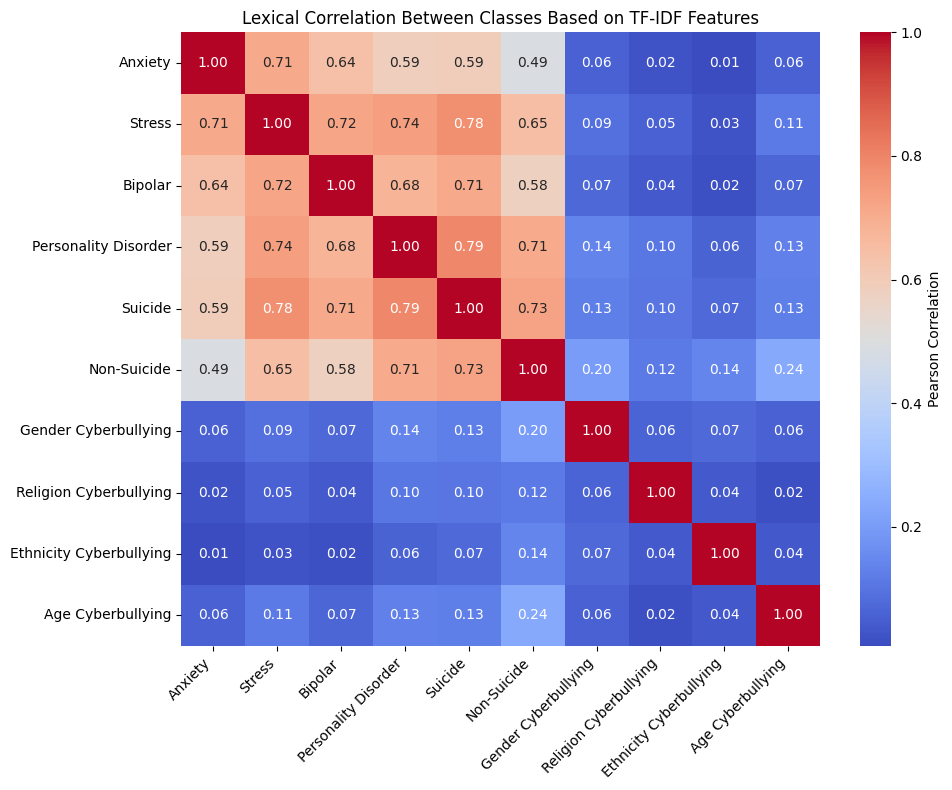

In [56]:
# ==============================================================================
# REIMPLEMENTED TF-IDF CORRELATION ANALYSIS (with Custom Grouping)
# ==============================================================================
import pandas as pd
import numpy as np
from sklearn.feature_extraction.text import TfidfVectorizer
from scipy.stats import pearsonr
import seaborn as sns
import matplotlib.pyplot as plt

# --- Step 1: CHOOSE THE DATAFRAME TO ANALYZE ---
# We will use 'train_fully_balanced' as it contains rich data for all classes.
df_to_analyze = train_fully_balanced.copy()

# --- Step 2: Vectorize the entire text corpus ---
print("Vectorizing text using TF-IDF...")
vectorizer = TfidfVectorizer(max_features=1000, stop_words="english")
tfidf_matrix = vectorizer.fit_transform(df_to_analyze["text"].astype(str))
df_to_analyze['vectors'] = list(tfidf_matrix.toarray())

# --- Step 3: Compute the average TF-IDF vector PER CLASS ---
print("Computing average TF-IDF vector for each class...")
class_tfidf_means = df_to_analyze.groupby('status')['vectors'].apply(np.mean)

# ==============================================================================
# === NEW LOGIC: DEFINE AND APPLY THE CUSTOM ORDER FOR THE HEATMAP ===
# ==============================================================================

# 1. Define the desired order, grouping Mental Health and Cyberbullying classes
custom_order = [
    # Mental Health Classes
    'anxiety',
    'stress',
    'bipolar',
    'personality_disorder',
    'suicide',
    'non_suicide',
    # Cyberbullying Classes (grouped together)
    'gender_cb',
    'religion_cb',
    'ethnicity_cb',
    'age_cb'
]

# 2. Re-index the pandas Series to match your custom order
# This is the key step that rearranges the data before calculation.
class_tfidf_means = class_tfidf_means.reindex(custom_order)

# 3. Get the class names and vectors, which are now in your desired order
class_names_ordered = class_tfidf_means.index.tolist()
class_vectors_ordered = np.array(class_tfidf_means.tolist())
# ==============================================================================

# --- Step 4: Create the correlation matrix using the ordered data ---
print("Creating the correlation matrix based on the custom order...")
n_classes = len(class_names_ordered)
correlation_matrix = np.zeros((n_classes, n_classes))

for i in range(n_classes):
    for j in range(i, n_classes):
        corr, _ = pearsonr(class_vectors_ordered[i], class_vectors_ordered[j])
        correlation_matrix[i, j] = corr
        correlation_matrix[j, i] = corr  # Symmetric

# --- Step 5: Plot the heatmap with the custom order ---

# Your name map for creating pretty labels
name_map = {
    'age_cb': 'Age Cyberbullying', 'anxiety': 'Anxiety', 'bipolar': 'Bipolar', 'ethnicity_cb': 'Ethnicity Cyberbullying',
    'gender_cb': 'Gender Cyberbullying', 'non_suicide': 'Non-Suicide', 'personality_disorder': 'Personality Disorder',
    'religion_cb': 'Religion Cyberbullying', 'stress': 'Stress', 'suicide': 'Suicide'
}

# Create the labels in the same custom order for the plot axes
mapped_labels = [name_map.get(name, name) for name in class_names_ordered]

print("Plotting the heatmap with grouped classes...")
plt.figure(figsize=(10, 8))
sns.heatmap(
    correlation_matrix,
    annot=True,
    fmt=".2f",
    cmap="coolwarm",
    xticklabels=mapped_labels, # Use the ordered labels
    yticklabels=mapped_labels, # Use the ordered labels
    cbar_kws={'label': 'Pearson Correlation'}
)
plt.title("Lexical Correlation Between Classes Based on TF-IDF Features")
plt.xticks(rotation=45, ha="right")
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

## Post lenght Analysis for the Datasets after cleaning

In [57]:
# ==============================================================================
# REIMPLEMENTED: Post Length Analysis using groupby()
# This code works on your single, merged dataframe.
# ==============================================================================
import pandas as pd
from tabulate import tabulate

# --- Step 1: Choose the DataFrame to Analyze ---
# Using 'master_df' is best because it represents the entire, original dataset
# before any sampling, giving the most accurate statistics.
df_to_analyze = master_df.copy()

print("Analyzing average post length per class from the master DataFrame...")

# --- Step 2: Calculate Lengths for all rows at once (very efficient) ---
# Ensure 'text' column is string type and handle any potential non-string data
df_to_analyze['text'] = df_to_analyze['text'].astype(str)
# Calculate character length
df_to_analyze['char_length'] = df_to_analyze['text'].str.len()
# Calculate word count
df_to_analyze['word_count'] = df_to_analyze['text'].str.split().str.len()

# --- Step 3: Group by 'status' and Aggregate the results ---
# This is the core of the new method.
# We group the dataframe by the class label and then calculate the mean for our new columns.
length_stats = df_to_analyze.groupby('status').agg(
    avg_char_length=('char_length', 'mean'),
    avg_word_length=('word_count', 'mean')
).round(2) # Round the results to 2 decimal places

# --- Step 4: Format and Print the final table ---

# Your map for creating pretty labels for the output table
name_map = {
    'age_cb': 'Age Cyberbullying', 'anxiety': 'Anxiety', 'bipolar': 'Bipolar', 'ethnicity_cb': 'Ethnicity Cyberbullying',
    'gender_cb': 'Gender Cyberbullying', 'non_suicide': 'Non-Suicide', 'personality_disorder': 'Personality Disorder',
    'religion_cb': 'Religion Cyberbullying', 'stress': 'Stress', 'suicide': 'Suicide'
}

# Rename the index of our results table using the map
length_stats.index = length_stats.index.map(name_map)
length_stats = length_stats.rename_axis('Dataset') # Set the index column name

# Rename the columns for the final printout
length_stats.columns = ['Post Length (Characters)', 'Post Length (Words)']

# Print the final result using tabulate for nice formatting
print("\n" + "="*80)
print("Average Post Length Statistics Per Class (from Master DataFrame)")
print("="*80)
print(tabulate(length_stats, headers='keys', tablefmt='fancy_grid'))

Analyzing average post length per class from the master DataFrame...



Average Post Length Statistics Per Class (from Master DataFrame)
╒═════════════════════════╤════════════════════════════╤═══════════════════════╕
│ Dataset                 │   Post Length (Characters) │   Post Length (Words) │
╞═════════════════════════╪════════════════════════════╪═══════════════════════╡
│ Age Cyberbullying       │                     165.38 │                 31.96 │
├─────────────────────────┼────────────────────────────┼───────────────────────┤
│ Anxiety                 │                     731.49 │                141.97 │
├─────────────────────────┼────────────────────────────┼───────────────────────┤
│ Bipolar                 │                     916.55 │                176.51 │
├─────────────────────────┼────────────────────────────┼───────────────────────┤
│ Ethnicity Cyberbullying │                     123.54 │                 23.9  │
├─────────────────────────┼────────────────────────────┼───────────────────────┤
│ Gender Cyberbullying    │                

# Word Count Analysis

In [58]:
# ==============================================================================
# REIMPLEMENTED: Word Count Statistics (min, avg, max) using groupby()
# This code works on your single, merged dataframe.
# ==============================================================================
import pandas as pd
from tabulate import tabulate

# --- Step 1: Choose the DataFrame to Analyze ---
# Using 'master_df' is best as it represents the entire, original dataset
# before any sampling, giving the most accurate statistics.
df_to_analyze = final_train_df.copy()

print("Analyzing word count statistics (min, avg, max) per class from the final training DataFrame...")

# --- Step 2: Calculate the word count for every row at once ---
# This is a fast, vectorized operation.
df_to_analyze['word_count'] = df_to_analyze['text'].astype(str).str.split().str.len()

# --- Step 3: Group by 'status' and apply multiple aggregations at once ---
# This is the most efficient way to get min, mean, and max for each group.
word_stats_df = df_to_analyze.groupby('status')['word_count'].agg(['min', 'mean', 'max'])

# --- Step 4: Format the resulting DataFrame for a clean presentation ---

# Rename the columns to be more descriptive
word_stats_df.rename(columns={
    'min': 'Min Words',
    'mean': 'Average Words',
    'max': 'Max Words'
}, inplace=True)

# Your map for creating pretty labels for the output table
name_map = {
    'age_cb': 'Age Cyberbullying', 'anxiety': 'Anxiety', 'bipolar': 'Bipolar', 'ethnicity_cb': 'Ethnicity Cyberbullying',
    'gender_cb': 'Gender Cyberbullying', 'non_suicide': 'Non-Suicide', 'personality_disorder': 'Personality Disorder',
    'religion_cb': 'Religion Cyberbullying', 'stress': 'Stress', 'suicide': 'Suicide'
}

# Rename the index (the class names) using the map to make them pretty
word_stats_df.index = word_stats_df.index.map(name_map)
word_stats_df = word_stats_df.rename_axis('Dataset') # Set the index column name

# --- Step 5: Print the final, formatted table ---
print("\n" + "="*80)
print("Word Count Statistics Per Class (from Master DataFrame)")
print("="*80)
print(tabulate(word_stats_df, headers='keys', tablefmt='fancy_grid', floatfmt=".2f"))

Analyzing word count statistics (min, avg, max) per class from the final training DataFrame...

Word Count Statistics Per Class (from Master DataFrame)
╒═════════════════════════╤═════════════╤═════════════════╤═════════════╕
│ Dataset                 │   Min Words │   Average Words │   Max Words │
╞═════════════════════════╪═════════════╪═════════════════╪═════════════╡
│ Age Cyberbullying       │        2.00 │           32.71 │       61.00 │
├─────────────────────────┼─────────────┼─────────────────┼─────────────┤
│ Anxiety                 │        2.00 │          142.57 │     1575.00 │
├─────────────────────────┼─────────────┼─────────────────┼─────────────┤
│ Bipolar                 │        4.00 │          176.80 │     4783.00 │
├─────────────────────────┼─────────────┼─────────────────┼─────────────┤
│ Ethnicity Cyberbullying │        1.00 │           23.90 │      309.00 │
├─────────────────────────┼─────────────┼─────────────────┼─────────────┤
│ Gender Cyberbullying    │       

# Feature Correlation -- Unbalanced dataset

**Step 1:** Correlation Analysis (Using Dataset Names as Labels)
We’ll compute correlations between datasets based on their TF-IDF vectors and visualize them in a heatmap.

## Model Training and Evaluation

In [59]:
# ====================================================================================
# SECTION: BASELINE ML CLASSIFIERS (TF-IDF + LogReg/SVM) - COMPLETE AND SELF-CONTAINED
# This entire block should be one section in your notebook.
# ====================================================================================
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.linear_model import LogisticRegressionCV
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
import pandas as pd
import joblib

# ============================================================
# === HELPER FUNCTION: store_model_results (INCLUDED HERE) ===
# ============================================================
def store_model_results(name, y_true, y_pred, class_indices, results_dict, class_name_map):
    """
    Calculates and stores model evaluation metrics.
    Uses a class name map for consistent reporting.
    """
    # Get the string names of the classes in the correct order
    ordered_class_names = [class_name_map[i] for i in class_indices]

    report = classification_report(y_true, y_pred, output_dict=True, labels=class_indices, target_names=ordered_class_names, zero_division=0)
    conf_matrix = confusion_matrix(y_true, y_pred, labels=class_indices)

    results_dict[name] = {
        'accuracy': accuracy_score(y_true, y_pred),
        'macro_f1': report['macro avg']['f1-score'],
        'weighted_f1': report['weighted avg']['f1-score'],
        'precision': report['macro avg']['precision'],
        'recall': report['macro avg']['recall'],
        'class_f1': [report[c]['f1-score'] for c in ordered_class_names],
        'class_recall': [report[c]['recall'] for c in ordered_class_names],
        'class_precision': [report[c]['precision'] for c in ordered_class_names],
        'confusion': conf_matrix
    }
# ============================================================

# Initialize a dictionary to store all our results
model_results = {}


In [60]:
# # --- STEP 1: DEFINE THE DATA FOR THIS EXPERIMENT ---
# # CHOOSE YOUR TRAINING DATASET HERE:
# # You can switch between 'final_train_df' and 'train_fully_balanced'
# training_df = train_fully_balanced 
# testing_df = test_df

# X_train = training_df['text']
# y_train = training_df['encoded_status']

# X_test = testing_df['text']
# y_test = testing_df['encoded_status']

# # Create the map from numeric code to string name (e.g., {0: 'anxiety', 1: 'bipolar', ...})
# # 'status_map' should have been created during your data preparation steps.
# class_name_map = status_map 
# # Get the class names in the correct order for the final report display
# class_names_for_display = list(class_name_map.values())

# print("Data is ready for baseline models.")
# print(f"Training on {len(X_train)} samples, testing on {len(X_test)} samples.")


In [61]:
# ==============================================================================
# FINAL, ROBUST DATA SETUP FOR MODEL TRAINING
# ==============================================================================

# --- STEP 1: DEFINE THE DATA FOR THIS EXPERIMENT ---
# CHOOSE YOUR TRAINING DATASET HERE:
# You can switch between 'train_downsampled_only' and 'train_fully_balanced'
training_df = train_fully_balanced 
testing_df = test_df

# ============================================================
# === THE FIX IS HERE: Drop NaNs from the final dataframes ===
# ============================================================
print("Performing final NaN check on training and testing dataframes...")

# Check and clean the training dataframe
initial_train_rows = len(training_df)
training_df.dropna(subset=['text', 'encoded_status'], inplace=True)
final_train_rows = len(training_df)
if initial_train_rows != final_train_rows:
    print(f"  - Removed {initial_train_rows - final_train_rows} rows with NaNs from the training data.")

# Check and clean the testing dataframe
initial_test_rows = len(testing_df)
testing_df.dropna(subset=['text', 'encoded_status'], inplace=True)
final_test_rows = len(testing_df)
if initial_test_rows != final_test_rows:
    print(f"  - Removed {initial_test_rows - final_test_rows} rows with NaNs from the testing data.")
# ============================================================


# --- Now, define your X and y variables from the cleaned dataframes ---
X_train = training_df['text']
y_train = training_df['encoded_status']

X_test = testing_df['text']
y_test = testing_df['encoded_status']

# --- The rest of your setup is correct ---
# Create the map from numeric code to string name
class_name_map = status_map 
# Get the class names in the correct order for the final report display
class_names_for_display = list(class_name_map.values())

print("\\nData is ready for baseline models.")
print(f"Training on {len(X_train)} samples, testing on {len(X_test)} samples.")
print(f"Training on {len(y_train)} samples, testing on {len(y_test)} samples.")

Performing final NaN check on training and testing dataframes...
  - Removed 2641 rows with NaNs from the training data.
\nData is ready for baseline models.
Training on 21339 samples, testing on 6000 samples.
Training on 21339 samples, testing on 6000 samples.


# Storing Model results

In [62]:
# ==============================================================================
# YOUR store_model_results FUNCTION, WITH THE MINIMAL NECESSARY FIX
# ==============================================================================
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score

def store_model_results(name, y_true, y_pred, class_indices, target_names, results_dict):
    """
    Calculates and stores model evaluation metrics robustly.
    This version correctly separates numeric indices from string names.
    """
    # The 'labels' parameter uses the numeric indices.
    # The 'target_names' parameter uses the string names.
    report = classification_report(
        y_true, 
        y_pred, 
        output_dict=True, 
        labels=class_indices, 
        target_names=target_names, 
        zero_division=0
    )
    
    # The confusion matrix also uses the numeric indices for ordering.
    conf_matrix = confusion_matrix(y_true, y_pred, labels=class_indices)

    results_dict[name] = {
        'accuracy': accuracy_score(y_true, y_pred),
        'macro_f1': report['macro avg']['f1-score'],
        'weighted_f1': report['weighted avg']['f1-score'],
        'precision': report['macro avg']['precision'],
        'recall': report['macro avg']['recall'],
        # The keys in the 'report' dict are the string names, so we loop through 'target_names'.
        'class_f1': [report[c]['f1-score'] for c in target_names],
        'class_recall': [report[c]['recall'] for c in target_names],
        'class_precision': [report[c]['precision'] for c in target_names],
        'confusion': conf_matrix
    }
    print(f"Results for '{name}' have been stored successfully.")

## TFIDF Embeddings + Logistic Regression

In [63]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
# Recompute if necessary
from sklearn.feature_extraction.text import TfidfVectorizer

# --- STEP 2: PREPARE TF-IDF FEATURES ---
print("Vectorizing text with TF-IDF (max_features=5000)...")
vectorizer = TfidfVectorizer(max_features=5000, stop_words="english", ngram_range=(1, 2))
X_train_tfidf = vectorizer.fit_transform(X_train)
X_test_tfidf = vectorizer.transform(X_test)
print("TF-IDF features are ready.")

# ============================================================
# MODEL 1: TF-IDF + LOGISTIC REGRESSION
# ============================================================
print("--- Training TF-IDF + Logistic Regression ---")
clf_tfidf_logreg = LogisticRegressionCV(
    Cs=[0.1, 1, 10], multi_class='multinomial', solver='saga',
    max_iter=1000, cv=3, scoring='f1_macro', n_jobs=-1, verbose=False
)
clf_tfidf_logreg.fit(X_train_tfidf, y_train)
y_pred_logreg = clf_tfidf_logreg.predict(X_test_tfidf)

# Store results and print the report
# store_model_results("TFIDF_LogReg", y_test, y_pred_logreg, clf_tfidf_logreg.classes_, model_results, class_name_map) # BAD

numeric_labels = clf_tfidf_logreg.classes_
string_labels = list(class_name_map.values()) # or class_names_for_display
results_dictionary = model_results

Vectorizing text with TF-IDF (max_features=5000)...


TF-IDF features are ready.
--- Training TF-IDF + Logistic Regression ---


/jet/home/eajayi1/MBD/jayi/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1946: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.8. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(


In [64]:
# ============================================================
# === FINAL, CORRECTED FUNCTION CALL ===
# ============================================================

# --- Step 1: Prepare the arguments correctly ---

# 1. The numeric labels from the trained classifier (e.g., [0, 1, 2...])
numeric_labels = clf_tfidf_logreg.classes_

# 2. THE FIX: The list of string names, created from the map in the correct order.
#    'status_map' is your dictionary like {0: 'anxiety', 1: 'bipolar', ...}
string_labels = [status_map[i] for i in numeric_labels]

# 3. The dictionary where results will be stored.
results_dictionary = model_results


# --- Step 2: Call the function with the correctly prepared variables ---
store_model_results(
    name="TFIDF_LogReg",
    y_true=y_test,
    y_pred=y_pred_logreg,
    class_indices=numeric_labels,   # This is a list of numbers
    target_names=string_labels,     # This is now guaranteed to be a list of strings
    results_dict=results_dictionary
)

# --- Step 3: Print the report ---
# You can reuse the 'string_labels' list here as well.
print("="*80)
print("=== TF-IDF + Logistic Regression Classification Report ===")
print("="*80)
print(classification_report(y_test, y_pred_logreg, target_names=string_labels))

Results for 'TFIDF_LogReg' have been stored successfully.
=== TF-IDF + Logistic Regression Classification Report ===
                      precision    recall  f1-score   support

              age_cb       0.84      0.95      0.90       175
             anxiety       0.42      0.88      0.57        80
             bipolar       0.33      0.71      0.45        55
        ethnicity_cb       0.80      0.94      0.86       172
           gender_cb       0.54      0.87      0.67       167
         non_suicide       0.89      0.81      0.85      2549
personality_disorder       0.32      0.70      0.44        20
         religion_cb       0.90      0.97      0.93       175
              stress       0.11      0.58      0.19        50
             suicide       0.93      0.82      0.87      2557

            accuracy                           0.82      6000
           macro avg       0.61      0.82      0.67      6000
        weighted avg       0.87      0.82      0.84      6000



In [65]:
model_results

{'TFIDF_LogReg': {'accuracy': 0.8243333333333334,
  'macro_f1': 0.671940184685318,
  'weighted_f1': 0.8423867656734378,
  'precision': 0.6086511530830709,
  'recall': 0.8214699857240865,
  'class_f1': [0.8954423592493298,
   0.5714285714285714,
   0.44571428571428573,
   0.8632707774798928,
   0.6666666666666666,
   0.8471849865951743,
   0.4375,
   0.931129476584022,
   0.1901639344262295,
   0.8709007887090079],
  'class_recall': [0.9542857142857143,
   0.875,
   0.7090909090909091,
   0.936046511627907,
   0.8682634730538922,
   0.8058061985092193,
   0.7,
   0.9657142857142857,
   0.58,
   0.8204927649589363],
  'class_precision': [0.8434343434343434,
   0.42424242424242425,
   0.325,
   0.8009950248756219,
   0.5410447761194029,
   0.8930434782608696,
   0.3181818181818182,
   0.898936170212766,
   0.11372549019607843,
   0.9279080053073862],
  'confusion': array([[ 167,    1,    0,    0,    0,    7,    0,    0,    0,    0],
         [   0,   70,    2,    0,    0,    3,    0,    0

# SVM + TF-IDF Embeddings

In [66]:
from sklearn.linear_model import LogisticRegressionCV

# ============================================================
# MODEL 2: TF-IDF + SUPPORT VECTOR MACHINE (SVM)
# ============================================================
print("--- Training TF-IDF + SVM with GridSearchCV ---")
grid_search = GridSearchCV(
    estimator=SVC(kernel='linear'), param_grid={'C': [0.01, 0.1, 1, 10]},
    scoring='f1_macro', cv=5, n_jobs=-1, verbose=2
)
grid_search.fit(X_train_tfidf, y_train)
clf_tfidf_svm = grid_search.best_estimator_
y_pred_svm = clf_tfidf_svm.predict(X_test_tfidf)

# Store results and print the report
store_model_results("TFIDF_SVM_GridCV", y_test, y_pred_svm, clf_tfidf_svm.classes_, model_results, class_name_map)
print("="*80)
print("=== TF-IDF + SVM (with GridSearchCV) Classification Report ===")
print("="*80)
print(classification_report(y_test, y_pred_svm, target_names=class_names_for_display))
print("="*80)

--- Training TF-IDF + SVM with GridSearchCV ---
Fitting 5 folds for each of 4 candidates, totalling 20 fits


Results for 'TFIDF_SVM_GridCV' have been stored successfully.
=== TF-IDF + SVM (with GridSearchCV) Classification Report ===
                      precision    recall  f1-score   support

              age_cb       0.88      0.97      0.92       175
             anxiety       0.41      0.88      0.56        80
             bipolar       0.27      0.71      0.39        55
        ethnicity_cb       0.78      0.97      0.86       172
           gender_cb       0.48      0.88      0.62       167
         non_suicide       0.88      0.79      0.83      2549
personality_disorder       0.18      0.65      0.28        20
         religion_cb       0.91      0.96      0.94       175
              stress       0.10      0.52      0.17        50
             suicide       0.93      0.78      0.85      2557

            accuracy                           0.80      6000
           macro avg       0.58      0.81      0.64      6000
        weighted avg       0.87      0.80      0.83      6000



/jet/home/eajayi1/MBD/jayi/lib/python3.12/site-packages/sklearn/metrics/_classification.py:2964: UserWarning: labels size, 10, does not match size of target_names, 1
  warnings.warn(


In [67]:
# ============================================================
# === CORRECTED: Storing Results for TF-IDF + SVM ===
# ============================================================

# --- Step 1: Prepare the arguments correctly ---

# 1. The numeric labels from the trained SVM classifier
numeric_labels_svm = clf_tfidf_svm.classes_

# 2. The list of string names, created from the map in the correct order
#    This ensures the list is perfectly aligned with the numeric order
string_labels_svm = [status_map[i] for i in numeric_labels_svm]

# 3. The dictionary where results will be stored
results_dictionary = model_results


# --- Step 2: Call the function with the arguments in the correct order ---
store_model_results(
    name="TFIDF_SVM_GridCV",
    y_true=y_test,
    y_pred=y_pred_svm,
    class_indices=numeric_labels_svm,   # Pass the numbers
    target_names=string_labels_svm,     # Pass the strings
    results_dict=results_dictionary
)


# --- Step 3: Print the report ---
# You can reuse the 'string_labels_svm' list here for consistency
print("="*80)
print("=== TF-IDF + SVM (with GridSearchCV) Classification Report ===")
print("="*80)
print(classification_report(y_test, y_pred_svm, target_names=string_labels_svm))
print("="*80)

Results for 'TFIDF_SVM_GridCV' have been stored successfully.
=== TF-IDF + SVM (with GridSearchCV) Classification Report ===
                      precision    recall  f1-score   support

              age_cb       0.88      0.97      0.92       175
             anxiety       0.41      0.88      0.56        80
             bipolar       0.27      0.71      0.39        55
        ethnicity_cb       0.78      0.97      0.86       172
           gender_cb       0.48      0.88      0.62       167
         non_suicide       0.88      0.79      0.83      2549
personality_disorder       0.18      0.65      0.28        20
         religion_cb       0.91      0.96      0.94       175
              stress       0.10      0.52      0.17        50
             suicide       0.93      0.78      0.85      2557

            accuracy                           0.80      6000
           macro avg       0.58      0.81      0.64      6000
        weighted avg       0.87      0.80      0.83      6000



In [68]:
# ============================================================
# SAVING THE COMPLETE PIPELINE (MODEL + VECTORIZER)
# ============================================================
import joblib

# # 1. Save the trained model (your code is correct)
joblib.dump(clf_tfidf_logreg, 'tfidf_logreg_cv_model.joblib')
print("Trained Logistic Regression model saved to 'tfidf_logreg_cv_model.joblib'")

# 2. Save the fitted vectorizer (THE CRUCIAL ADDITION)
joblib.dump(vectorizer, 'tfidf_vectorizer.joblib')
print("Fitted TF-IDF vectorizer saved to 'tfidf_vectorizer.joblib'")

Trained Logistic Regression model saved to 'tfidf_logreg_cv_model.joblib'
Fitted TF-IDF vectorizer saved to 'tfidf_vectorizer.joblib'


In [69]:
model_results.keys()

dict_keys(['TFIDF_LogReg', 'TFIDF_SVM_GridCV'])

In [70]:
# ============================================================
# LOADING AND REUSING THE SAVED PIPELINE
# ============================================================
import joblib
# You still need the original imports for the objects to load correctly
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.linear_model import LogisticRegressionCV

print("Loading the saved model and vectorizer...")
# 1. Load the vectorizer AND the model
loaded_vectorizer = joblib.load('tfidf_vectorizer.joblib')
loaded_model = joblib.load('tfidf_logreg_cv_model.joblib')
print("Pipeline loaded successfully.")

# 2. Prepare some new, unseen text data
new_posts = [
    "I've been feeling so stressed and anxious about work, I can't seem to relax.",
    "that person is so annoying, they keep making fun of my age and calling me old"
]

# 3. Transform the new text using the LOADED vectorizer
new_posts_tfidf = loaded_vectorizer.transform(new_posts)

# 4. Make predictions with the LOADED model
predictions_numeric = loaded_model.predict(new_posts_tfidf)

# 5. Map the numeric predictions back to their string names
# Assumes 'status_map' is your dictionary like {0: 'anxiety', 1: 'bipolar', ...}
predicted_class_names = [status_map[p] for p in predictions_numeric]

print("--- New Predictions ---")
for i in range(len(new_posts)):
    print(f"Post: '{new_posts[i]}'")
    print(f"  -> Predicted Class: {predicted_class_names[i]}")

Loading the saved model and vectorizer...
Pipeline loaded successfully.
--- New Predictions ---
Post: 'I've been feeling so stressed and anxious about work, I can't seem to relax.'
  -> Predicted Class: stress
Post: 'that person is so annoying, they keep making fun of my age and calling me old'
  -> Predicted Class: non_suicide


In [71]:
# ============================================================
# FOR REUSE == TESTING (Corrected Version)
# ============================================================
import joblib
from sklearn.metrics import classification_report
# You will also need the vectorizer for this to be a complete test
# from sklearn.feature_extraction.text import TfidfVectorizer 

# --- A complete reuse block should look like this ---

print("Loading the saved model and vectorizer...")
# 1. Load BOTH the model and the vectorizer
loaded_model = joblib.load('tfidf_logreg_cv_model.joblib')
loaded_vectorizer = joblib.load('tfidf_vectorizer.joblib')

# Assume 'X_test' (the raw text) and 'y_test' (the true numeric labels) are available
# 2. Transform the test data using the LOADED vectorizer
X_test_tfidf = loaded_vectorizer.transform(X_test)

# 3. Use the loaded model to predict
print("Making predictions with the loaded model...")
# We save the predictions into 'y_pred_new' to be clear
y_pred_new = loaded_model.predict(X_test_tfidf)

# 4. Print the report using the NEW predictions
print("\\n=== TF-IDF + Logistic Regression Classification Report (from loaded model) ===")
# Use the SAME variable 'y_pred_new' here
print(classification_report(y_test, y_pred_new, target_names=class_names_for_display))

Loading the saved model and vectorizer...


Making predictions with the loaded model...
\n=== TF-IDF + Logistic Regression Classification Report (from loaded model) ===
                      precision    recall  f1-score   support

              age_cb       0.84      0.95      0.90       175
             anxiety       0.42      0.88      0.57        80
             bipolar       0.33      0.71      0.45        55
        ethnicity_cb       0.80      0.94      0.86       172
           gender_cb       0.54      0.87      0.67       167
         non_suicide       0.89      0.81      0.85      2549
personality_disorder       0.32      0.70      0.44        20
         religion_cb       0.90      0.97      0.93       175
              stress       0.11      0.58      0.19        50
             suicide       0.93      0.82      0.87      2557

            accuracy                           0.82      6000
           macro avg       0.61      0.82      0.67      6000
        weighted avg       0.87      0.82      0.84      6000



# BERT Embeddings + LogReg

In [72]:
# ====================================================================================
# SECTION: FROZEN BERT EMBEDDINGS + LOGISTIC REGRESSION (CORRECTED CALL)
# ====================================================================================
import torch
from transformers import BertTokenizer, BertModel
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report
import numpy as np
import pandas as pd

# --- STEP 1 & 2: Load Model and Define Helper Function (No changes needed) ---
print("Loading pre-trained BERT model for feature extraction...")
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
tokenizer = BertTokenizer.from_pretrained("bert-base-uncased")
bert_model = BertModel.from_pretrained("bert-base-uncased").to(device)
bert_model.eval()

def get_bert_embedding(text):
    inputs = tokenizer(text, return_tensors="pt", truncation=True, padding=True, max_length=128).to(device)
    with torch.no_grad():
        outputs = bert_model(**inputs)
    return outputs.last_hidden_state[:, 0, :].cpu().numpy()

# --- STEP 3: Generate Embeddings (No changes needed) ---
print(f"Generating BERT embeddings for {len(training_df)} training samples...")
X_train_list = training_df['text'].tolist()
X_train_bert = np.vstack([get_bert_embedding(text) for text in X_train_list])

print(f"Generating BERT embeddings for {len(testing_df)} testing samples...")
X_test_list = testing_df['text'].tolist()
X_test_bert = np.vstack([get_bert_embedding(text) for text in X_test_list])

y_train = training_df['encoded_status'].values
y_test = testing_df['encoded_status'].values
print("BERT embeddings are ready.")

Loading pre-trained BERT model for feature extraction...
Generating BERT embeddings for 21339 training samples...
Generating BERT embeddings for 6000 testing samples...
BERT embeddings are ready.


In [73]:
# ============================================================
# MODEL: FROZEN BERT + LOGISTIC REGRESSION
# ============================================================
print("\\n--- Training Frozen BERT + Logistic Regression ---")
clf_bert_logreg = LogisticRegression(max_iter=1000, solver='saga', multi_class='multinomial')
clf_bert_logreg.fit(X_train_bert, y_train)
y_pred_bert_logreg = clf_bert_logreg.predict(X_test_bert)

# ============================================================
# === FIX IS HERE: The function call now matches your working function ===
# ============================================================
# Prepare the arguments correctly
numeric_labels = clf_bert_logreg.classes_
string_labels = list(status_map.values()) # Assumes status_map is your {0:'anxiety', ...} dict
# ============================================================

\n--- Training Frozen BERT + Logistic Regression ---


/jet/home/eajayi1/MBD/jayi/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1272: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.8. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(


[CV] END .............................................C=0.01; total time= 2.1min
[CV] END ..............................................C=0.1; total time= 1.2min
[CV] END ................................................C=1; total time=  46.3s
[CV] END ...............................................C=10; total time=  43.9s
[CV] END .............................................C=0.01; total time= 2.1min
[CV] END ..............................................C=0.1; total time= 1.2min
[CV] END ................................................C=1; total time=  46.3s
[CV] END ...............................................C=10; total time=  43.5s
[CV] END .............................................C=0.01; total time= 2.1min
[CV] END ..............................................C=0.1; total time= 1.2min
[CV] END ................................................C=1; total time=  46.3s
[CV] END ...............................................C=10; total time=  43.5s
[CV] END ...................

/jet/home/eajayi1/MBD/jayi/lib/python3.12/site-packages/sklearn/linear_model/_sag.py:348: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


In [74]:
# ============================================================
# FINAL, CORRECT CELL FOR STORING BERT+LOGREG RESULTS
# ============================================================
import joblib
from sklearn.metrics import classification_report

# --- Step 1: Prepare the arguments for the store_model_results function ---
# The numeric labels (e.g., [0, 1, 2...]) from the trained classifier
numeric_labels = clf_bert_logreg.classes_

# The string labels (e.g., ['anxiety', 'bipolar'...]) from your status_map
string_labels = class_names_for_display 

# --- Step 2: Call the function with all required arguments ---
# YOUR CODE IS PERFECT:
store_model_results(
    name="BERT_LogReg",
    y_true=y_test,
    y_pred=y_pred_bert_logreg,
    class_indices=numeric_labels,   # The numbers
    target_names=string_labels,     # The strings
    results_dict=model_results
)

# --- Step 3: Print the final report ---
print("="*80)
print("=== Frozen BERT + Logistic Regression Classification Report ===")
print("="*80)
print(classification_report(y_test, y_pred_bert_logreg, target_names=string_labels))
print("="*80)
# # --- Step 4: Save the trained model for reuse ---
# joblib.dump(clf_bert_logreg, 'bert_logreg_model.joblib')
# print("nTrained BERT+LogReg model saved to 'bert_logreg_model.joblib'")

Results for 'BERT_LogReg' have been stored successfully.
=== Frozen BERT + Logistic Regression Classification Report ===
                      precision    recall  f1-score   support

              age_cb       0.62      0.89      0.73       175
             anxiety       0.30      0.76      0.43        80
             bipolar       0.16      0.65      0.26        55
        ethnicity_cb       0.60      0.89      0.72       172
           gender_cb       0.37      0.87      0.52       167
         non_suicide       0.92      0.68      0.78      2549
personality_disorder       0.08      0.50      0.14        20
         religion_cb       0.83      0.96      0.89       175
              stress       0.10      0.60      0.17        50
             suicide       0.93      0.79      0.85      2557

            accuracy                           0.75      6000
           macro avg       0.49      0.76      0.55      6000
        weighted avg       0.86      0.75      0.79      6000



In [75]:
model_results.keys()

dict_keys(['TFIDF_LogReg', 'TFIDF_SVM_GridCV', 'BERT_LogReg'])

# BERT Embeddings + RNN

In [76]:
# ====================================================================================
# SECTION: FROZEN BERT EMBEDDINGS + RECURRENT NEURAL NETWORK (RNN)
# ====================================================================================
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
from transformers import BertTokenizer, BertModel
from sklearn.metrics import classification_report
import numpy as np

# --- STEP 1: DEFINE THE DATA FOR THIS EXPERIMENT ---
# This code assumes 'training_df' and 'testing_df' are your final, prepared DataFrames.
# You can switch which training set you use for your ablation study here.
# training_df = train_downsampled_only
# training_df = train_fully_balanced

# Get the true labels for training and testing
y_train = training_df['encoded_status'].values
y_test = testing_df['encoded_status'].values
print(f"Data is ready for RNN model. Training on {len(training_df)} samples, testing on {len(testing_df)} samples.")

# --- STEP 2: GENERATE BERT EMBEDDINGS (if they don't already exist) ---
# We check if the embeddings were already created in the previous Logistic Regression step.
try:
    # Check if variables exist and have the correct shape
    if X_train_bert.shape[0] == len(training_df) and X_test_bert.shape[0] == len(testing_df):
        print("Using existing BERT embeddings from the previous step.")
    else:
        raise NameError # Force re-creation if shapes don't match
except NameError:
    print("BERT embeddings not found or have incorrect shape, generating them now...")
    # This logic is copied from the previous (correct) Logistic Regression cell
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    tokenizer = BertTokenizer.from_pretrained("bert-base-uncased")
    bert_model = BertModel.from_pretrained("bert-base-uncased").to(device)
    bert_model.eval()
    def get_bert_embedding(text):
        inputs = tokenizer(text, return_tensors="pt", truncation=True, padding=True, max_length=128).to(device)
        with torch.no_grad():
            outputs = bert_model(**inputs)
        return outputs.last_hidden_state[:, 0, :].cpu().numpy()

    X_train_bert = np.vstack([get_bert_embedding(text) for text in training_df['text'].tolist()])
    X_test_bert = np.vstack([get_bert_embedding(text) for text in testing_df['text'].tolist()])
    print("BERT embeddings are ready.")

# ============================================================
# PYTORCH MODEL: SIMPLE RNN
# ============================================================

# --- Your RNN Class Definition (no changes needed) ---
class SimpleRNN(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(SimpleRNN, self).__init__()
        self.rnn = nn.RNN(input_dim, hidden_dim, batch_first=True)
        self.fc = nn.Linear(hidden_dim, output_dim)

    def forward(self, x):
        h0 = torch.zeros(1, x.size(0), self.rnn.hidden_size).to(x.device)
        out, _ = self.rnn(x.unsqueeze(1), h0)
        return self.fc(out[:, -1, :])

# --- Model Setup ---
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
hidden_dim = 128
output_dim = len(class_names_for_display) # Use the correct number of classes

rnn_model = SimpleRNN(X_train_bert.shape[1], hidden_dim, output_dim).to(device)
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(rnn_model.parameters(), lr=0.001)

# --- DataLoader ---
train_data = TensorDataset(torch.FloatTensor(X_train_bert), torch.LongTensor(y_train))
train_loader = DataLoader(train_data, batch_size=64, shuffle=True)

# --- Training Loop ---
print("--- Training Frozen BERT + RNN ---")
for epoch in range(5):
    rnn_model.train()
    for x_batch, y_batch in train_loader:
        x_batch, y_batch = x_batch.to(device), y_batch.to(device)
        optimizer.zero_grad()
        loss = criterion(rnn_model(x_batch), y_batch)
        loss.backward()
        optimizer.step()
    print(f"Epoch {epoch+1}/5 completed.")

# --- Evaluation ---
rnn_model.eval()
with torch.no_grad():
    # Ensure test data is on the correct device
    X_test_tensor = torch.FloatTensor(X_test_bert).to(device)
    logits = rnn_model(X_test_tensor)
    y_pred_bert_rnn = torch.argmax(logits, dim=1).cpu().numpy()

Data is ready for RNN model. Training on 21339 samples, testing on 6000 samples.
Using existing BERT embeddings from the previous step.
--- Training Frozen BERT + RNN ---


Epoch 1/5 completed.
Epoch 2/5 completed.
Epoch 3/5 completed.
Epoch 4/5 completed.
Epoch 5/5 completed.


In [77]:
# ============================================================
# 1. Get the list of all unique NUMERIC labels present in your test set.
#    We sort them to ensure a consistent [0, 1, 2, ..., 9] order.
numeric_indices = sorted(np.unique(y_test).tolist())

# 2. Get the corresponding STRING names in that same order using status_map.
#    'status_map' should be your dictionary like {0: 'anxiety', 1: 'bipolar', ...}
string_names = [status_map[i] for i in numeric_indices]

# 3. Call your working `store_model_results` function with the correct arguments.
store_model_results(
    name="BERT_RNN",
    y_true=y_test,
    y_pred=y_pred_bert_rnn,
    class_indices=numeric_indices,  # Pass the sorted numbers
    target_names=string_names,      # Pass the corresponding strings
    results_dict=model_results
)
# ============================================================



Results for 'BERT_RNN' have been stored successfully.


In [78]:
# --- Print Report and Save Model (Unchanged) ---
print("="*80)
print("=== Frozen BERT + RNN Classification Report ===")
print("="*80)
print(classification_report(y_test, y_pred_bert_rnn, target_names=string_names))
print("="*80)
# torch.save(rnn_model.state_dict(), "bert_rnn_model.pt")
# print("Trained BERT+RNN model saved to 'bert_rnn_model.pt'")

=== Frozen BERT + RNN Classification Report ===
                      precision    recall  f1-score   support

              age_cb       0.56      0.89      0.69       175
             anxiety       0.28      0.78      0.41        80
             bipolar       0.24      0.53      0.33        55
        ethnicity_cb       0.53      0.90      0.67       172
           gender_cb       0.36      0.87      0.51       167
         non_suicide       0.94      0.63      0.76      2549
personality_disorder       0.17      0.40      0.24        20
         religion_cb       0.85      0.95      0.90       175
              stress       0.12      0.48      0.19        50
             suicide       0.90      0.88      0.89      2557

            accuracy                           0.77      6000
           macro avg       0.49      0.73      0.56      6000
        weighted avg       0.85      0.77      0.79      6000



## Storing model results -- PyTorch Models

In [79]:
# ==============================================================================
# FINAL, ROBUST CODE FOR PREPARING LABELS FOR PLOTTING
# ==============================================================================

# --- 1. START with the definitive map from your data preparation ---
# We assume 'status_map' is the dictionary {0: 'age_cb', 1: 'anxiety', ...},
# even if it has some extra dirty keys, we will only use the numeric ones.

# --- 2. Define your desired "pretty" names for each backend name ---
# This dictionary is your single source of truth for display names.
pretty_name_map = {
    'age_cb': 'Age CB',
    'anxiety': 'Anxiety',
    'bipolar': 'Bipolar',
    'ethnicity_cb': 'Ethnicity CB',
    'gender_cb': 'Gender CB',
    'non_suicide': 'Non-Suicide',
    'personality_disorder': 'Personality Disorder',
    'religion_cb': 'Religion CB',
    'stress': 'Stress',
    'suicide': 'Suicide'
}

# ============================================================
# === FIX IS HERE: A safer way to get the labels ===
# ============================================================
# 1. Get the list of all unique NUMERIC labels from your data.
#    We use the keys from status_map but filter to keep ONLY the integers.
numeric_indices = sorted([k for k in status_map.keys() if isinstance(k, int)])

# 2. Get the corresponding backend STRING names in that same order.
backend_names = [status_map[i] for i in numeric_indices]

# 3. Create the FINAL, correctly-ordered list of PRETTY names.
#    This is the list you will use for all your plots.
final_class_names_for_plotting = [pretty_name_map.get(name, name) for name in backend_names]
# ============================================================


# --- 4. Use this final list for all your plots and tables ---
# print("This list is now guaranteed to be in the correct order for plotting:")
print(final_class_names_for_plotting)

# Example usage in a plot (this is now safe):
# plt.xticks(ticks, final_class_names_for_plotting, rotation=45)
# sns.heatmap(..., xticklabels=final_class_names_for_plotting, yticklabels=final_class_names_for_plotting)

# Example usage for creating a results DataFrame:
# This assumes 'model_results' is your dictionary of stored results
# and 'model

['Age CB', 'Anxiety', 'Bipolar', 'Ethnicity CB', 'Gender CB', 'Non-Suicide', 'Personality Disorder', 'Religion CB', 'Stress', 'Suicide']


In [80]:
# def store_model_results2(name, y_true, y_pred, class_names, results_dict):
#     # Create a list of numerical labels, e.g., [0, 1, 2, ..., 9]
#     numerical_labels = list(range(len(class_names)))

#     # For the report, use numerical labels for matching and ordering,
#     # but the string names for the final dictionary keys.
#     report = classification_report(y_true, y_pred, output_dict=True,
#                                    labels=numerical_labels,
#                                    target_names=class_names,
#                                    zero_division=0)

#     # For the confusion matrix, use the correct numerical labels.
#     conf_matrix = confusion_matrix(y_true, y_pred, labels=numerical_labels)

#     results_dict[name] = {
#         'accuracy': accuracy_score(y_true, y_pred),
#         'macro_f1': report['macro avg']['f1-score'],
#         'weighted_f1': report['weighted avg']['f1-score'],
#         'precision': report['macro avg']['precision'],
#         'recall': report['macro avg']['recall'],
#         'class_f1': [report[c]['f1-score'] for c in class_names],
#         'class_recall': [report[c]['recall'] for c in class_names],
#         'class_precision': [report[c]['precision'] for c in class_names],
#         'confusion': conf_matrix
#     }

In [81]:
# ====================================================================================
# SECTION: FROZEN BERT EMBEDDINGS + DEEP NEURAL NETWORK (DNN)
# ====================================================================================
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
from sklearn.metrics import classification_report

# --- STEP 1: VERIFY BERT EMBEDDINGS ---
# This code assumes that 'X_train_bert', 'y_train', 'X_test_bert', and 'y_test'
# were correctly created in the previous steps from your final dataframes.
try:
    if X_train_bert.shape[0] > 0 and X_test_bert.shape[0] > 0:
        print("Using existing BERT embeddings for DNN training.")
        print(f"Training data shape: {X_train_bert.shape}, Test data shape: {X_test_bert.shape}")
    else:
        raise NameError # This should not happen if the previous cells ran
except NameError:
    print("FATAL ERROR: BERT embedding variables (X_train_bert, X_test_bert) not found.")
    print("Please re-run the 'Frozen BERT + Logistic Regression' cell to generate them.")
    raise

# ============================================================
# PYTORCH MODEL: FEEDFORWARD NEURAL NETWORK (DNN)
# ============================================================

# --- Your DNN Class Definition (no changes needed) ---
# Note: I added a second hidden layer and dropout as described in your paper's appendix
class BERTFeedforward(nn.Module):
    def __init__(self, input_dim, hidden_dim1, hidden_dim2, output_dim, dropout_rate1=0.3, dropout_rate2=0.2):
        super(BERTFeedforward, self).__init__()
        self.net = nn.Sequential(
            nn.Linear(input_dim, hidden_dim1),
            nn.ReLU(),
            nn.Dropout(dropout_rate1),
            nn.Linear(hidden_dim1, hidden_dim2),
            nn.ReLU(),
            nn.Dropout(dropout_rate2),
            nn.Linear(hidden_dim2, output_dim)
        )

    def forward(self, x):
        return self.net(x)

# --- Model Setup ---
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
input_dim = X_train_bert.shape[1]
hidden_dim1 = 256
hidden_dim2 = 128
output_dim = len(class_names_for_display) # Use the correct number of classes

model_ffn = BERTFeedforward(input_dim, hidden_dim1, hidden_dim2, output_dim).to(device)
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model_ffn.parameters(), lr=0.001)

# --- DataLoader ---
train_ds = TensorDataset(torch.FloatTensor(X_train_bert), torch.LongTensor(y_train))
train_dl = DataLoader(train_ds, batch_size=64, shuffle=True)

# --- Training Loop ---
print("\\n--- Training Frozen BERT + DNN ---")
for epoch in range(5):
    model_ffn.train()
    for xb, yb in train_dl:
        xb, yb = xb.to(device), yb.to(device)
        optimizer.zero_grad()
        loss = criterion(model_ffn(xb), yb)
        loss.backward()
        optimizer.step()
    print(f"Epoch {epoch+1}/5 completed.")

# --- Evaluation ---
model_ffn.eval()
with torch.no_grad():
    X_test_tensor = torch.FloatTensor(X_test_bert).to(device)
    logits = model_ffn(X_test_tensor)
    y_pred_ffn = torch.argmax(logits, dim=1).cpu().numpy()


Using existing BERT embeddings for DNN training.
Training data shape: (21339, 768), Test data shape: (6000, 768)
\n--- Training Frozen BERT + DNN ---


Epoch 1/5 completed.
Epoch 2/5 completed.
Epoch 3/5 completed.
Epoch 4/5 completed.
Epoch 5/5 completed.


In [82]:
# --- Store Results and Print Report ---
# Use the same robust method as the RNN to get the labels
numeric_indices = sorted(np.unique(y_test).tolist())
string_names = [status_map[i] for i in numeric_indices]

store_model_results(
    name="BERT_DNN",
    y_true=y_test,
    y_pred=y_pred_ffn,
    class_indices=numeric_indices,
    target_names=string_names,
    results_dict=model_results
)
print("="*80)
print("=== Frozen BERT + DNN Classification Report ===")
print("="*80)
print(classification_report(y_test, y_pred_ffn, target_names=class_names_for_display))
print("="*80)
# --- Save the Trained PyTorch Model ---
# torch.save(model_ffn.state_dict(), "bert_dnn_model.pt")
# print("Trained BERT+DNN model saved to 'bert_dnn_model.pt'")

Results for 'BERT_DNN' have been stored successfully.
=== Frozen BERT + DNN Classification Report ===
                      precision    recall  f1-score   support

              age_cb       0.82      0.77      0.79       175
             anxiety       0.34      0.70      0.46        80
             bipolar       0.08      0.71      0.15        55
        ethnicity_cb       0.65      0.88      0.75       172
           gender_cb       0.33      0.88      0.48       167
         non_suicide       0.94      0.59      0.73      2549
personality_disorder       0.14      0.15      0.14        20
         religion_cb       0.75      0.96      0.84       175
              stress       0.08      0.56      0.14        50
             suicide       0.89      0.81      0.84      2557

            accuracy                           0.72      6000
           macro avg       0.50      0.70      0.53      6000
        weighted avg       0.86      0.72      0.76      6000



# Fine-tuned BERT

In [83]:
# ====================================================================================
# SECTION: FINE-TUNED BERT FOR SEQUENCE CLASSIFICATION
# This is your main experiment.
# ====================================================================================
# NEW, CORRECT IMPORTS
from transformers import BertTokenizer, BertForSequenceClassification
from torch.optim import AdamW
from torch.utils.data import Dataset, DataLoader
from sklearn.metrics import classification_report
import torch
import numpy as np

# --- STEP 1: DEFINE THE DATA FOR THIS EXPERIMENT ---
# This code assumes 'training_df' and 'testing_df' are your final, prepared DataFrames.
# You can switch which training set you use for your ablation study here.
# training_df = train_downsampled_only
# training_df = train_fully_balanced

# Get the raw text and labels as lists
train_texts = training_df['text'].tolist()
train_labels = training_df['encoded_status'].tolist()
test_texts = testing_df['text'].tolist()
test_labels = testing_df['encoded_status'].tolist()

# --- Create a validation set from the training data for early stopping ---
from sklearn.model_selection import train_test_split
train_texts, val_texts, train_labels, val_labels = train_test_split(
    train_texts, train_labels, test_size=0.1, random_state=42, stratify=train_labels
)

print(f"Data is ready for Fine-Tuning. Training: {len(train_texts)}, Validation: {len(val_texts)}, Test: {len(test_texts)}")

# --- Your BERTDataset Class (no changes needed) ---
class BERTDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_len=128):
        self.texts = texts
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len
    def __len__(self):
        return len(self.texts)
    def __getitem__(self, idx):
        inputs = self.tokenizer(self.texts[idx], padding='max_length', truncation=True, max_length=self.max_len, return_tensors="pt")
        return {'input_ids': inputs['input_ids'].squeeze(0), 'attention_mask': inputs['attention_mask'].squeeze(0), 'labels': torch.tensor(self.labels[idx], dtype=torch.long)}

# --- Tokenizer and Model ---
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
bert_model = BertForSequenceClassification.from_pretrained('bert-base-uncased', num_labels=len(class_names_for_display)).to(device)

# --- Datasets + DataLoaders (including validation set) ---
train_ds = BERTDataset(train_texts, train_labels, tokenizer)
val_ds = BERTDataset(val_texts, val_labels, tokenizer)
test_ds = BERTDataset(test_texts, test_labels, tokenizer)

train_dl = DataLoader(train_ds, batch_size=16, shuffle=True)
val_dl = DataLoader(val_ds, batch_size=16)
test_dl = DataLoader(test_ds, batch_size=16)

# --- Optimizer and Early Stopping Setup ---
optimizer = AdamW(bert_model.parameters(), lr=2e-5)
patience = 2
patience_counter = 0
best_val_loss = float('inf')
best_model_path = 'best_finetuned_bert_model.pt'

# --- Training and Validation Loop ---
print("\\n--- Starting Fine-Tuning of BERT ---")
for epoch in range(6): # Max 6 epochs
    bert_model.train()
    total_train_loss = 0
    for batch in train_dl:
        optimizer.zero_grad()
        outputs = bert_model(input_ids=batch['input_ids'].to(device), attention_mask=batch['attention_mask'].to(device), labels=batch['labels'].to(device))
        loss = outputs.loss
        total_train_loss += loss.item()
        loss.backward()
        optimizer.step()
    avg_train_loss = total_train_loss / len(train_dl)

    # Validation phase
    bert_model.eval()
    total_val_loss = 0
    with torch.no_grad():
        for batch in val_dl:
            outputs = bert_model(input_ids=batch['input_ids'].to(device), attention_mask=batch['attention_mask'].to(device), labels=batch['labels'].to(device))
            loss = outputs.loss
            total_val_loss += loss.item()
    avg_val_loss = total_val_loss / len(val_dl)
    print(f"Epoch {epoch+1}/6 | Train Loss: {avg_train_loss:.4f} | Val Loss: {avg_val_loss:.4f}")

    # Early Stopping Check
    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        torch.save(bert_model.state_dict(), best_model_path)
        patience_counter = 0
        print(f"  -> Validation loss improved. Saving model to {best_model_path}")
    else:
        patience_counter += 1
        print(f"  -> Validation loss did not improve. Patience: {patience_counter}/{patience}")
    if patience_counter >= patience:
        print("  -> Early stopping triggered.")
        break

# --- Final Evaluation on the Test Set ---
# Load the best model state before final evaluation
print(f"\\nLoading best model from {best_model_path} for final evaluation on the test set.")
bert_model.load_state_dict(torch.load(best_model_path))
bert_model.eval()
preds, true_labels = [], []
with torch.no_grad():
    for batch in test_dl:
        outputs = bert_model(input_ids=batch['input_ids'].to(device), attention_mask=batch['attention_mask'].to(device))
        logits = outputs.logits
        preds.extend(logits.argmax(dim=1).cpu().numpy())
        true_labels.extend(batch['labels'].cpu().numpy())



Data is ready for Fine-Tuning. Training: 19205, Validation: 2134, Test: 6000


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


\n--- Starting Fine-Tuning of BERT ---
Epoch 1/6 | Train Loss: 0.6297 | Val Loss: 0.3400
  -> Validation loss improved. Saving model to best_finetuned_bert_model.pt
Epoch 2/6 | Train Loss: 0.2446 | Val Loss: 0.3204
  -> Validation loss improved. Saving model to best_finetuned_bert_model.pt
Epoch 3/6 | Train Loss: 0.1295 | Val Loss: 0.3750
  -> Validation loss did not improve. Patience: 1/2
Epoch 4/6 | Train Loss: 0.0715 | Val Loss: 0.3879
  -> Validation loss did not improve. Patience: 2/2
  -> Early stopping triggered.
\nLoading best model from best_finetuned_bert_model.pt for final evaluation on the test set.


In [84]:
# ==============================================================================
# --- CORRECTED: Store Results and Print Report ---
# ==============================================================================

# 1. Get the list of all unique NUMERIC labels from your ground truth data.
#    We sort them to ensure a consistent [0, 1, 2, ..., 9] order.
numeric_indices = sorted(np.unique(true_labels).tolist())

# 2. Get the corresponding STRING names in that same order using status_map.
#    'status_map' should be your dictionary like {0: 'anxiety', 1: 'bipolar', ...}
string_names = [status_map[i] for i in numeric_indices]

# 3. Call your working `store_model_results` function with the correct arguments.
store_model_results(
    name="BERT_Finetuned",
    y_true=true_labels,
    y_pred=preds,
    class_indices=numeric_indices,  # Pass the sorted numbers
    target_names=string_names,      # Pass the corresponding strings
    results_dict=model_results
)

# --- Print Report and Save Model (Unchanged) ---
print("\\n=== Fine-Tuned BERT Classification Report (Best Model) ===")
print(classification_report(true_labels, preds, target_names=class_names_for_display))

# bert_model.save_pretrained("final_finetuned_bert_model")
# tokenizer.save_pretrained("final_finetuned_bert_model")
# print("\\nFinal best model and tokenizer saved to 'final_finetuned_bert_model' directory.")

Results for 'BERT_Finetuned' have been stored successfully.
\n=== Fine-Tuned BERT Classification Report (Best Model) ===
                      precision    recall  f1-score   support

              age_cb       0.93      0.96      0.94       175
             anxiety       0.72      0.89      0.79        80
             bipolar       0.73      0.80      0.77        55
        ethnicity_cb       0.82      0.97      0.89       172
           gender_cb       0.53      0.93      0.68       167
         non_suicide       0.97      0.87      0.92      2549
personality_disorder       0.24      0.65      0.35        20
         religion_cb       0.91      0.97      0.94       175
              stress       0.30      0.78      0.43        50
             suicide       0.98      0.95      0.96      2557

            accuracy                           0.91      6000
           macro avg       0.71      0.88      0.77      6000
        weighted avg       0.94      0.91      0.92      6000



In [85]:
model_results.keys()

dict_keys(['TFIDF_LogReg', 'TFIDF_SVM_GridCV', 'BERT_LogReg', 'BERT_RNN', 'BERT_DNN', 'BERT_Finetuned'])

# MentalBERT - Finetuned

In [86]:
# from huggingface_hub import login
# import os

# login(token=os.getenv("HF_TOKEN"))


In [87]:
# ====================================================================================
# EXPERIMENT: FINE-TUNED 'MentalBERT' (Stronger, Domain-Adapted Baseline)
# ====================================================================================
# Use AutoClasses for flexibility to handle different model types easily
from transformers import AutoTokenizer, AutoModelForSequenceClassification
from torch.optim import AdamW
from torch.utils.data import Dataset, DataLoader
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split
import torch
import numpy as np

# --- STEP 1: DEFINE THE DATA FOR THIS EXPERIMENT ---
# This code assumes 'training_df' and 'testing_df' are your final, prepared DataFrames.
# It uses the same split as your previous models for a fair comparison.

# Get the raw text and labels as lists
train_texts = training_df['text'].tolist()
train_labels = training_df['encoded_status'].tolist()
test_texts = testing_df['text'].tolist()
test_labels = testing_df['encoded_status'].tolist()

# Create a validation set from the training data for early stopping
train_texts, val_texts, train_labels, val_labels = train_test_split(
    train_texts, train_labels, test_size=0.1, random_state=42, stratify=train_labels
)

print(f"Data is ready for MentalBERT Fine-Tuning. Training: {len(train_texts)}, Validation: {len(val_texts)}, Test: {len(test_texts)}")

# --- BERTDataset Class (no changes needed) ---
class BERTDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_len=128):
        self.texts = texts
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len
    def __len__(self):
        return len(self.texts)
    def __getitem__(self, idx):
        inputs = self.tokenizer(self.texts[idx], padding='max_length', truncation=True, max_length=self.max_len, return_tensors="pt")
        return {'input_ids': inputs['input_ids'].squeeze(0), 'attention_mask': inputs['attention_mask'].squeeze(0), 'labels': torch.tensor(self.labels[idx], dtype=torch.long)}

# --- Tokenizer and Model ---
# This is the key change to use MentalBERT
MODEL_NAME = 'mental/mental-bert-base-uncased'
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

print(f"Loading tokenizer and model for '{MODEL_NAME}'...")
# AutoTokenizer automatically fetches the correct tokenizer for the specified model
tokenizer = AutoTokenizer.from_pretrained(MODEL_NAME)
# AutoModelForSequenceClassification automatically fetches the correct model architecture
model = AutoModelForSequenceClassification.from_pretrained(MODEL_NAME, num_labels=len(class_names_for_display)).to(device)
print("Model and tokenizer loaded successfully.")

# --- Datasets + DataLoaders (including validation set) ---
# These will now use the MentalBERT tokenizer
train_ds = BERTDataset(train_texts, train_labels, tokenizer)
val_ds = BERTDataset(val_texts, val_labels, tokenizer)
test_ds = BERTDataset(test_texts, test_labels, tokenizer)

train_dl = DataLoader(train_ds, batch_size=16, shuffle=True)
val_dl = DataLoader(val_ds, batch_size=16)
test_dl = DataLoader(test_ds, batch_size=16)

# --- Optimizer and Early Stopping Setup ---
optimizer = AdamW(model.parameters(), lr=2e-5)
patience = 2
patience_counter = 0
best_val_loss = float('inf')
# Use a unique name for the saved model file
best_model_path = 'best_finetuned_mentalbert.pt'

# --- Training and Validation Loop ---
print(f"\\n--- Starting Fine-Tuning of {MODEL_NAME} ---")
for epoch in range(6): # Max 6 epochs
    model.train()
    total_train_loss = 0
    for batch in train_dl:
        optimizer.zero_grad()
        outputs = model(input_ids=batch['input_ids'].to(device), attention_mask=batch['attention_mask'].to(device), labels=batch['labels'].to(device))
        loss = outputs.loss
        total_train_loss += loss.item()
        loss.backward()
        optimizer.step()
    avg_train_loss = total_train_loss / len(train_dl)

    # Validation phase
    model.eval()
    total_val_loss = 0
    with torch.no_grad():
        for batch in val_dl:
            outputs = model(input_ids=batch['input_ids'].to(device), attention_mask=batch['attention_mask'].to(device), labels=batch['labels'].to(device))
            loss = outputs.loss
            total_val_loss += loss.item()
    avg_val_loss = total_val_loss / len(val_dl)
    print(f"Epoch {epoch+1}/6 | Train Loss: {avg_train_loss:.4f} | Val Loss: {avg_val_loss:.4f}")

    # Early Stopping Check
    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        torch.save(model.state_dict(), best_model_path)
        patience_counter = 0
        print(f"  -> Validation loss improved. Saving model to {best_model_path}")
    else:
        patience_counter += 1
        print(f"  -> Validation loss did not improve. Patience: {patience_counter}/{patience}")
    if patience_counter >= patience:
        print("  -> Early stopping triggered.")
        break

# --- Final Evaluation on the Test Set ---
print(f"\\nLoading best model from {best_model_path} for final evaluation on the test set.")
model.load_state_dict(torch.load(best_model_path))
model.eval()
preds, true_labels = [], []
with torch.no_grad():
    for batch in test_dl:
        outputs = model(input_ids=batch['input_ids'].to(device), attention_mask=batch['attention_mask'].to(device))
        logits = outputs.logits
        preds.extend(logits.argmax(dim=1).cpu().numpy())
        true_labels.extend(batch['labels'].cpu().numpy())


Data is ready for MentalBERT Fine-Tuning. Training: 19205, Validation: 2134, Test: 6000
Loading tokenizer and model for 'mental/mental-bert-base-uncased'...


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at mental/mental-bert-base-uncased and are newly initialized: ['bert.pooler.dense.bias', 'bert.pooler.dense.weight', 'classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Model and tokenizer loaded successfully.
\n--- Starting Fine-Tuning of mental/mental-bert-base-uncased ---
Epoch 1/6 | Train Loss: 0.5107 | Val Loss: 0.3275
  -> Validation loss improved. Saving model to best_finetuned_mentalbert.pt
Epoch 2/6 | Train Loss: 0.2040 | Val Loss: 0.2935
  -> Validation loss improved. Saving model to best_finetuned_mentalbert.pt
Epoch 3/6 | Train Loss: 0.1064 | Val Loss: 0.3027
  -> Validation loss did not improve. Patience: 1/2
Epoch 4/6 | Train Loss: 0.0582 | Val Loss: 0.3827
  -> Validation loss did not improve. Patience: 2/2
  -> Early stopping triggered.
\nLoading best model from best_finetuned_mentalbert.pt for final evaluation on the test set.


In [88]:
# 1. Get the list of all unique NUMERIC labels from your ground truth data.
#    We sort them to ensure a consistent [0, 1, 2, ..., 9] order.
numeric_indices = sorted(np.unique(true_labels).tolist())

# 2. Get the corresponding STRING names in that same order using status_map.
#    'status_map' should be your dictionary like {0: 'anxiety', 1: 'bipolar', ...}
string_names = [status_map[i] for i in numeric_indices]

# Use a unique name for storing the results
store_model_results(
    name="BERT_Finetuned_MentalBERT",
    y_true=true_labels,
    y_pred=preds,
    class_indices=numeric_indices,
    target_names=string_names,
    results_dict=model_results
)

print(f"\\n=== Fine-Tuned {MODEL_NAME} Classification Report (Best Model) ===")
print(classification_report(true_labels, preds, target_names=class_names_for_display))

# --- Save the final best model for explainability and reuse ---
# Use a unique directory for this model
output_dir = "final_finetuned_mentalbert_model"
model.save_pretrained(output_dir)
tokenizer.save_pretrained(output_dir)
print(f"\\nFinal best model and tokenizer for {MODEL_NAME} saved to '{output_dir}' directory.")

Results for 'BERT_Finetuned_MentalBERT' have been stored successfully.
\n=== Fine-Tuned mental/mental-bert-base-uncased Classification Report (Best Model) ===
                      precision    recall  f1-score   support

              age_cb       0.89      0.97      0.93       175
             anxiety       0.51      0.90      0.65        80
             bipolar       0.48      0.82      0.61        55
        ethnicity_cb       0.80      0.98      0.88       172
           gender_cb       0.75      0.96      0.84       167
         non_suicide       0.96      0.90      0.93      2549
personality_disorder       0.29      0.75      0.42        20
         religion_cb       0.95      0.98      0.96       175
              stress       0.28      0.74      0.40        50
             suicide       0.99      0.93      0.96      2557

            accuracy                           0.92      6000
           macro avg       0.69      0.89      0.76      6000
        weighted avg       0.94  

\nFinal best model and tokenizer for mental/mental-bert-base-uncased saved to 'final_finetuned_mentalbert_model' directory.


In [89]:
# ==============================================================================
# --- CORRECTED: Store Results and Print Report for MentalBERT ---
# ==============================================================================

# 1. Get the list of all unique NUMERIC labels from your ground truth data.
#    We sort them to ensure a consistent [0, 1, 2, ..., 9] order.
numeric_indices = sorted(np.unique(true_labels).tolist())

# 2. Get the corresponding STRING names in that same order using status_map.
#    'status_map' is your dictionary like {0: 'anxiety', 1: 'bipolar', ...}
string_names = [status_map[i] for i in numeric_indices]

# 3. Call your working `store_model_results` function with the correct arguments.
#    Use a unique name for storing the results.
store_model_results(
    name="BERT_Finetuned_MentalBERT",
    y_true=true_labels,
    y_pred=preds,
    class_indices=numeric_indices,  # Pass the sorted numbers
    target_names=string_names,      # Pass the corresponding strings
    results_dict=model_results
)

# --- Print Report and Save Model (Unchanged) ---
print(f"\\n=== Fine-Tuned {MODEL_NAME} Classification Report (Best Model) ===")
print(classification_report(true_labels, preds, target_names=class_names_for_display))

# Use a unique directory for this model
output_dir = "final_finetuned_mentalbert_model"
model.save_pretrained(output_dir)
tokenizer.save_pretrained(output_dir)
print(f"\\nFinal best model and tokenizer for {MODEL_NAME} saved to '{output_dir}' directory.")

Results for 'BERT_Finetuned_MentalBERT' have been stored successfully.
\n=== Fine-Tuned mental/mental-bert-base-uncased Classification Report (Best Model) ===
                      precision    recall  f1-score   support

              age_cb       0.89      0.97      0.93       175
             anxiety       0.51      0.90      0.65        80
             bipolar       0.48      0.82      0.61        55
        ethnicity_cb       0.80      0.98      0.88       172
           gender_cb       0.75      0.96      0.84       167
         non_suicide       0.96      0.90      0.93      2549
personality_disorder       0.29      0.75      0.42        20
         religion_cb       0.95      0.98      0.96       175
              stress       0.28      0.74      0.40        50
             suicide       0.99      0.93      0.96      2557

            accuracy                           0.92      6000
           macro avg       0.69      0.89      0.76      6000
        weighted avg       0.94  

\nFinal best model and tokenizer for mental/mental-bert-base-uncased saved to 'final_finetuned_mentalbert_model' directory.


# MentalBERT Baseline Evaluation on Test Set

In [90]:
# # ====================================================================================
# # SECTION: ZERO-SHOT EVALUATION of Pre-trained MentalBERT (Corrected)
# # ====================================================================================
# from transformers import AutoTokenizer, AutoModelForSequenceClassification
# from torch.utils.data import Dataset, DataLoader
# from sklearn.metrics import classification_report
# import torch
# import numpy as np

# # --- STEP 1, 2, 3, 4 (These are all correct and unchanged) ---

# # STEP 1: DEFINE THE TEST DATA
# test_texts = testing_df['text'].tolist()
# test_labels = testing_df['encoded_status'].tolist()
# print(f"Preparing to evaluate a pre-trained (zero-shot) MentalBERT on the final test set of {len(test_texts)} samples.")

# # BERTDataset Class Definition... (omitted for brevity, but should be in your notebook)

# # STEP 2: LOAD THE PRE-TRAINED MODEL
# MODEL_NAME = "mental/mental-bert-base-uncased" 
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# print(f"Loading PRE-TRAINED model and tokenizer for '{MODEL_NAME}' from Hugging Face Hub...")
# try:
#     tokenizer = AutoTokenizer.from_pretrained(MODEL_NAME)
#     model = AutoModelForSequenceClassification.from_pretrained(MODEL_NAME, num_labels=len(class_names_for_display)).to(device)
#     print("Model and tokenizer loaded successfully.")
# except Exception as e:
#     print(f"ERROR: Could not load the model. Make sure you are logged into Hugging Face.")
#     print(f"Details: {e}")
#     raise

# # STEP 3: PREPARE THE TEST DATALOADER
# test_ds = BERTDataset(test_texts, test_labels, tokenizer)
# test_dl = DataLoader(test_ds, batch_size=16)

# # STEP 4: RUN THE EVALUATION LOOP
# print("--- Running ZERO-SHOT evaluation on the test set... ---")
# model.eval()
# preds, true_labels = [], []
# with torch.no_grad():
#     for batch in test_dl:
#         inputs = {'input_ids': batch['input_ids'].to(device), 'attention_mask': batch['attention_mask'].to(device)}
#         outputs = model(**inputs)
#         logits = outputs.logits
#         preds.extend(logits.argmax(dim=1).cpu().numpy())
#         true_labels.extend(batch['labels'].cpu().numpy())
# print("Evaluation complete.")


# # ==============================================================================
# # --- STEP 5: STORE RESULTS AND PRINT THE FINAL CLASSIFICATION REPORT (FIXED) ---
# # ==============================================================================

# # 1. Get the list of all unique NUMERIC labels from your ground truth data.
# #    (This is the safe method you already had)
# numeric_indices = sorted(np.unique(true_labels).tolist())

# # 2. Get the corresponding STRING names in that same order using status_map.
# string_names = [status_map[i] for i in numeric_indices]

# # 3. Call your working `store_model_results` function with these CORRECT variables.
# store_model_results(
#     name="MentalBERT_ZeroShot",
#     y_true=true_labels,
#     y_pred=preds,
#     class_indices=numeric_indices,  # Use the safe numeric list
#     target_names=string_names,      # Use the corresponding string list
#     results_dict=model_results
# )

# # 4. Print the final report.
# print(f"\\n=== ZERO-SHOT MentalBERT Classification Report (on Test Set) ===")
# print(classification_report(true_labels, preds, target_names=class_names_for_display, digits=4))

In [91]:
# ====================================================================================
# EXPERIMENT: FINE-TUNED 'mental/mental-roberta-base' (Modern, Domain-Adapted Baseline)
# ====================================================================================
from transformers import AutoTokenizer, AutoModelForSequenceClassification
from torch.optim import AdamW
from torch.utils.data import Dataset, DataLoader
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split
import torch
import numpy as np

# --- STEP 1: DEFINE THE DATA FOR THIS EXPERIMENT ---
# This uses the exact same data split as the other models for a fair comparison.
# Assumes 'training_df' and 'testing_df' are your final, prepared DataFrames.
train_texts = training_df['text'].tolist()
train_labels = training_df['encoded_status'].tolist()
test_texts = testing_df['text'].tolist()
test_labels = testing_df['encoded_status'].tolist()

# Create a validation set from the training data for early stopping
train_texts, val_texts, train_labels, val_labels = train_test_split(
    train_texts, train_labels, test_size=0.1, random_state=42, stratify=train_labels
)

print(f"Data is ready for MentalRoBERTa Fine-Tuning. Training: {len(train_texts)}, Validation: {len(val_texts)}, Test: {len(test_texts)}")

# --- BERTDataset Class (no changes needed) ---
class BERTDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_len=128):
        self.texts = texts
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len
    def __len__(self):
        return len(self.texts)
    def __getitem__(self, idx):
        inputs = self.tokenizer(self.texts[idx], padding='max_length', truncation=True, max_length=self.max_len, return_tensors="pt")
        return {'input_ids': inputs['input_ids'].squeeze(0), 'attention_mask': inputs['attention_mask'].squeeze(0), 'labels': torch.tensor(self.labels[idx], dtype=torch.long)}

# --- Tokenizer and Model ---
# This is the key change to use MentalRoBERTa
MODEL_NAME = 'mental/mental-roberta-base'
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

print(f"Loading tokenizer and model for '{MODEL_NAME}'...")
# This requires you to be logged into Hugging Face via notebook_login()
tokenizer = AutoTokenizer.from_pretrained(MODEL_NAME)
# CRUCIAL: Use AutoModelForSequenceClassification to get the model with a classification head.
model = AutoModelForSequenceClassification.from_pretrained(MODEL_NAME, num_labels=len(class_names_for_display)).to(device)
print("Model and tokenizer loaded successfully.")

# --- Datasets + DataLoaders (including validation set) ---
train_ds = BERTDataset(train_texts, train_labels, tokenizer)
val_ds = BERTDataset(val_texts, val_labels, tokenizer)
test_ds = BERTDataset(test_texts, test_labels, tokenizer)

train_dl = DataLoader(train_ds, batch_size=16, shuffle=True)
val_dl = DataLoader(val_ds, batch_size=16)
test_dl = DataLoader(test_ds, batch_size=16)

# --- Optimizer and Early Stopping Setup ---
optimizer = AdamW(model.parameters(), lr=2e-5)
patience = 2
patience_counter = 0
best_val_loss = float('inf')
# Use a unique name for the saved model file
best_model_path = 'best_finetuned_mentalroberta.pt'

# --- Training and Validation Loop ---
print(f"\\n--- Starting Fine-Tuning of {MODEL_NAME} ---")
for epoch in range(6): # Max 6 epochs
    model.train()
    total_train_loss = 0
    for batch in train_dl:
        optimizer.zero_grad()
        outputs = model(input_ids=batch['input_ids'].to(device), attention_mask=batch['attention_mask'].to(device), labels=batch['labels'].to(device))
        loss = outputs.loss
        total_train_loss += loss.item()
        loss.backward()
        optimizer.step()
    avg_train_loss = total_train_loss / len(train_dl)

    # Validation phase
    model.eval()
    total_val_loss = 0
    with torch.no_grad():
        for batch in val_dl:
            outputs = model(input_ids=batch['input_ids'].to(device), attention_mask=batch['attention_mask'].to(device), labels=batch['labels'].to(device))
            loss = outputs.loss
            total_val_loss += loss.item()
    avg_val_loss = total_val_loss / len(val_dl)
    print(f"Epoch {epoch+1}/6 | Train Loss: {avg_train_loss:.4f} | Val Loss: {avg_val_loss:.4f}")

    # Early Stopping Check
    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        torch.save(model.state_dict(), best_model_path)
        patience_counter = 0
        print(f"  -> Validation loss improved. Saving model to {best_model_path}")
    else:
        patience_counter += 1
        print(f"  -> Validation loss did not improve. Patience: {patience_counter}/{patience}")
    if patience_counter >= patience:
        print("  -> Early stopping triggered.")
        break

# --- Final Evaluation on the Test Set ---
print(f"\\nLoading best model from {best_model_path} for final evaluation on the test set.")
model.load_state_dict(torch.load(best_model_path))
model.eval()
preds, true_labels = [], []
with torch.no_grad():
    for batch in test_dl:
        outputs = model(input_ids=batch['input_ids'].to(device), attention_mask=batch['attention_mask'].to(device))
        logits = outputs.logits
        preds.extend(logits.argmax(dim=1).cpu().numpy())
        true_labels.extend(batch['labels'].cpu().numpy())

# --- Store Results and Print Report ---
numeric_indices = sorted(np.unique(true_labels).tolist())
string_names = [status_map[i] for i in numeric_indices]

# Use a unique name for storing the results
store_model_results(
    name="RoBERTa_Finetuned_MentalRoBERTa",
    y_true=true_labels,
    y_pred=preds,
    class_indices=numeric_indices,
    target_names=string_names,
    results_dict=model_results
)

print(f"\\n=== Fine-Tuned {MODEL_NAME} Classification Report (Best Model) ===")
print(classification_report(true_labels, preds, target_names=class_names_for_display))

# --- Save the final best model for explainability and reuse ---
output_dir = "final_finetuned_mentalroberta_model"
model.save_pretrained(output_dir)
tokenizer.save_pretrained(output_dir)
print(f"\\nFinal best model and tokenizer for {MODEL_NAME} saved to '{output_dir}' directory.")

Data is ready for MentalRoBERTa Fine-Tuning. Training: 19205, Validation: 2134, Test: 6000
Loading tokenizer and model for 'mental/mental-roberta-base'...


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at mental/mental-roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Model and tokenizer loaded successfully.
\n--- Starting Fine-Tuning of mental/mental-roberta-base ---
Epoch 1/6 | Train Loss: 0.5209 | Val Loss: 0.3428
  -> Validation loss improved. Saving model to best_finetuned_mentalroberta.pt
Epoch 2/6 | Train Loss: 0.2359 | Val Loss: 0.2833
  -> Validation loss improved. Saving model to best_finetuned_mentalroberta.pt
Epoch 3/6 | Train Loss: 0.1387 | Val Loss: 0.3009
  -> Validation loss did not improve. Patience: 1/2
Epoch 4/6 | Train Loss: 0.0834 | Val Loss: 0.3584
  -> Validation loss did not improve. Patience: 2/2
  -> Early stopping triggered.
\nLoading best model from best_finetuned_mentalroberta.pt for final evaluation on the test set.
Results for 'RoBERTa_Finetuned_MentalRoBERTa' have been stored successfully.
\n=== Fine-Tuned mental/mental-roberta-base Classification Report (Best Model) ===
                      precision    recall  f1-score   support

              age_cb       0.93      0.96      0.94       175
             anxiety    

In [92]:
model_results.keys()

dict_keys(['TFIDF_LogReg', 'TFIDF_SVM_GridCV', 'BERT_LogReg', 'BERT_RNN', 'BERT_DNN', 'BERT_Finetuned', 'BERT_Finetuned_MentalBERT', 'RoBERTa_Finetuned_MentalRoBERTa'])

In [93]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score


## Saving all the model results stats to a csv file

In [94]:
results10v1 = pd.DataFrame(model_results)
results10v1.to_csv("results_balanced2.csv")



In [95]:
# results10v1

In [96]:
# model_results

# Model Comparism and Evaluation

In [97]:
# ====================================================================================
# FINAL RESULTS VISUALIZATION
# ====================================================================================
import pandas as pd

# --- Step 1: UPDATE the list of model names to match what you stored ---
# These should be the exact keys you used in the `store_model_results` function.
model_names = [
    'TFIDF_LogReg',
    'TFIDF_SVM_GridCV',
    'BERT_LogReg',
    'BERT_RNN',
    'BERT_DNN',
    'BERT_Finetuned',
    'BERT_Finetuned_MentalBERT',
    'RoBERTa_Finetuned_MentalRoBERTa'
]

# This is the correctly ordered list of pretty names for your columns/indices
# Assumes 'final_class_names_for_plotting' was created earlier
class_names = final_class_names_for_plotting 

# --- Overall Model Performance Table (Your code is correct) ---
overall_data = []
for name in model_names:
    # Use a try-except block to avoid errors if a model result is missing
    if name in model_results:
        overall_data.append({
            'Model': name,
            'Accuracy': model_results[name]['accuracy'],
            'Macro F1': model_results[name]['macro_f1'],
            'Weighted F1': model_results[name]['weighted_f1'],
            'Precision': model_results[name]['precision'],
            'Recall': model_results[name]['recall']
        })

# Create and style the DataFrame
overall_df = pd.DataFrame(overall_data).set_index('Model')
styled_overall = overall_df.style.background_gradient(cmap='Blues').format('{:.2f}').set_caption("Overall Model Performance Comparison")
display(styled_overall)


# ============================================================
# === FIX IS HERE: Correctly extracting per-class data ===
# ============================================================
# Extracting the per-class F1, Precision and Recall scores
class_f1_data = {name: model_results[name]['class_f1'] for name in model_names if name in model_results}
# CORRECTED: Use 'class_precision' and 'class_recall' keys
class_precision_data = {name: model_results[name]['class_precision'] for name in model_names if name in model_results}
class_recall_data = {name: model_results[name]['class_recall'] for name in model_names if name in model_results}
# ============================================================


# --- Per-Class F1-Score Table (Your code is correct) ---
per_class_f1_df = pd.DataFrame(class_f1_data, index=class_names).T # Transpose to have models as rows
styled_per_class_f1 = per_class_f1_df.style.background_gradient(cmap='Greens').format('{:.2f}').set_caption("Per-Class F1-Score Comparison")
display(styled_per_class_f1)

# --- Per-Class Precision Table (Corrected) ---
per_class_precision_df = pd.DataFrame(class_precision_data, index=class_names).T
styled_per_class_precision = per_class_precision_df.style.background_gradient(cmap='Oranges').format('{:.2f}').set_caption("Per-Class Precision Comparison")
display(styled_per_class_precision)

# --- Per-Class Recall Table (Corrected) ---
per_class_recall_df = pd.DataFrame(class_recall_data, index=class_names).T
styled_per_class_recall = per_class_recall_df.style.background_gradient(cmap='Purples').format('{:.2f}').set_caption("Per-Class Recall Comparison")
display(styled_per_class_recall)

,Accuracy,Macro F1,Weighted F1,Precision,Recall
Model,,,,,
TFIDF_LogReg,0.82,0.67,0.84,0.61,0.82
TFIDF_SVM_GridCV,0.80,0.64,0.83,0.58,0.81
BERT_LogReg,0.75,0.55,0.79,0.49,0.76
BERT_RNN,0.77,0.56,0.79,0.49,0.73
BERT_DNN,0.72,0.53,0.76,0.50,0.70
BERT_Finetuned,0.91,0.77,0.92,0.71,0.88
BERT_Finetuned_MentalBERT,0.92,0.76,0.93,0.69,0.89
RoBERTa_Finetuned_MentalRoBERTa,0.91,0.73,0.92,0.66,0.89


,Age CB,Anxiety,Bipolar,Ethnicity CB,Gender CB,Non-Suicide,Personality Disorder,Religion CB,Stress,Suicide
TFIDF_LogReg,0.90,0.57,0.45,0.86,0.67,0.85,0.44,0.93,0.19,0.87
TFIDF_SVM_GridCV,0.92,0.56,0.39,0.86,0.62,0.83,0.28,0.94,0.17,0.85
BERT_LogReg,0.73,0.43,0.26,0.72,0.52,0.78,0.14,0.89,0.17,0.85
BERT_RNN,0.69,0.41,0.33,0.67,0.51,0.76,0.24,0.90,0.19,0.89
BERT_DNN,0.79,0.46,0.15,0.75,0.48,0.73,0.14,0.84,0.14,0.84
BERT_Finetuned,0.94,0.79,0.77,0.89,0.68,0.92,0.35,0.94,0.43,0.96
BERT_Finetuned_MentalBERT,0.93,0.65,0.61,0.88,0.84,0.93,0.42,0.96,0.40,0.96
RoBERTa_Finetuned_MentalRoBERTa,0.94,0.64,0.59,0.86,0.73,0.91,0.31,0.95,0.45,0.96


,Age CB,Anxiety,Bipolar,Ethnicity CB,Gender CB,Non-Suicide,Personality Disorder,Religion CB,Stress,Suicide
TFIDF_LogReg,0.84,0.42,0.33,0.80,0.54,0.89,0.32,0.90,0.11,0.93
TFIDF_SVM_GridCV,0.88,0.41,0.27,0.78,0.48,0.88,0.18,0.91,0.10,0.93
BERT_LogReg,0.62,0.30,0.16,0.60,0.37,0.92,0.08,0.83,0.10,0.93
BERT_RNN,0.56,0.28,0.24,0.53,0.36,0.94,0.17,0.85,0.12,0.90
BERT_DNN,0.82,0.34,0.08,0.65,0.33,0.94,0.14,0.75,0.08,0.89
BERT_Finetuned,0.93,0.72,0.73,0.82,0.53,0.97,0.24,0.91,0.30,0.98
BERT_Finetuned_MentalBERT,0.89,0.51,0.48,0.80,0.75,0.96,0.29,0.95,0.28,0.99
RoBERTa_Finetuned_MentalRoBERTa,0.93,0.49,0.47,0.76,0.59,0.98,0.19,0.92,0.31,0.98


,Age CB,Anxiety,Bipolar,Ethnicity CB,Gender CB,Non-Suicide,Personality Disorder,Religion CB,Stress,Suicide
TFIDF_LogReg,0.95,0.88,0.71,0.94,0.87,0.81,0.70,0.97,0.58,0.82
TFIDF_SVM_GridCV,0.97,0.88,0.71,0.97,0.88,0.79,0.65,0.96,0.52,0.78
BERT_LogReg,0.89,0.76,0.65,0.89,0.87,0.68,0.50,0.96,0.60,0.79
BERT_RNN,0.89,0.78,0.53,0.90,0.87,0.63,0.40,0.95,0.48,0.88
BERT_DNN,0.77,0.70,0.71,0.88,0.88,0.59,0.15,0.96,0.56,0.81
BERT_Finetuned,0.96,0.89,0.80,0.97,0.93,0.87,0.65,0.97,0.78,0.95
BERT_Finetuned_MentalBERT,0.97,0.90,0.82,0.98,0.96,0.90,0.75,0.98,0.74,0.93
RoBERTa_Finetuned_MentalRoBERTa,0.96,0.91,0.80,0.98,0.96,0.85,0.75,0.98,0.80,0.94


In [98]:
# ====================================================================================
# FINAL RESULTS VISUALIZATION
# ====================================================================================
import pandas as pd

# --- Step 1: UPDATE the list of model names to match what you stored ---
# These should be the exact keys you used in the `store_model_results` function.
model_names = [
    'TFIDF_LogReg',
    'TFIDF_SVM_GridCV',
    'BERT_LogReg',
    'BERT_RNN',
    'BERT_DNN',
    # 'BERT_Finetuned',
    # 'BERT_Finetuned_MentalBERT',
    # 'RoBERTa_Finetuned_MentalRoBERTa'
]

# This is the correctly ordered list of pretty names for your columns/indices
# Assumes 'final_class_names_for_plotting' was created earlier
class_names = final_class_names_for_plotting 

# --- Overall Model Performance Table (Your code is correct) ---
overall_data = []
for name in model_names:
    # Use a try-except block to avoid errors if a model result is missing
    if name in model_results:
        overall_data.append({
            'Model': name,
            'Accuracy': model_results[name]['accuracy'],
            'Macro F1': model_results[name]['macro_f1'],
            'Weighted F1': model_results[name]['weighted_f1'],
            'Precision': model_results[name]['precision'],
            'Recall': model_results[name]['recall']
        })

# Create and style the DataFrame
overall_df = pd.DataFrame(overall_data).set_index('Model')
styled_overall = overall_df.style.background_gradient(cmap='Blues').format('{:.2f}').set_caption("Overall Model Performance Comparison")
display(styled_overall)


# ============================================================
# === FIX IS HERE: Correctly extracting per-class data ===
# ============================================================
# Extracting the per-class F1, Precision and Recall scores
class_f1_data = {name: model_results[name]['class_f1'] for name in model_names if name in model_results}
# CORRECTED: Use 'class_precision' and 'class_recall' keys
class_precision_data = {name: model_results[name]['class_precision'] for name in model_names if name in model_results}
class_recall_data = {name: model_results[name]['class_recall'] for name in model_names if name in model_results}
# ============================================================


# --- Per-Class F1-Score Table (Your code is correct) ---
per_class_f1_df = pd.DataFrame(class_f1_data, index=class_names).T # Transpose to have models as rows
styled_per_class_f1 = per_class_f1_df.style.background_gradient(cmap='Greens').format('{:.2f}').set_caption("Per-Class F1-Score Comparison")
display(styled_per_class_f1)

# --- Per-Class Precision Table (Corrected) ---
per_class_precision_df = pd.DataFrame(class_precision_data, index=class_names).T
styled_per_class_precision = per_class_precision_df.style.background_gradient(cmap='Oranges').format('{:.2f}').set_caption("Per-Class Precision Comparison")
display(styled_per_class_precision)

# --- Per-Class Recall Table (Corrected) ---
per_class_recall_df = pd.DataFrame(class_recall_data, index=class_names).T
styled_per_class_recall = per_class_recall_df.style.background_gradient(cmap='Purples').format('{:.2f}').set_caption("Per-Class Recall Comparison")
display(styled_per_class_recall)

,Accuracy,Macro F1,Weighted F1,Precision,Recall
Model,,,,,
TFIDF_LogReg,0.82,0.67,0.84,0.61,0.82
TFIDF_SVM_GridCV,0.80,0.64,0.83,0.58,0.81
BERT_LogReg,0.75,0.55,0.79,0.49,0.76
BERT_RNN,0.77,0.56,0.79,0.49,0.73
BERT_DNN,0.72,0.53,0.76,0.50,0.70


,Age CB,Anxiety,Bipolar,Ethnicity CB,Gender CB,Non-Suicide,Personality Disorder,Religion CB,Stress,Suicide
TFIDF_LogReg,0.90,0.57,0.45,0.86,0.67,0.85,0.44,0.93,0.19,0.87
TFIDF_SVM_GridCV,0.92,0.56,0.39,0.86,0.62,0.83,0.28,0.94,0.17,0.85
BERT_LogReg,0.73,0.43,0.26,0.72,0.52,0.78,0.14,0.89,0.17,0.85
BERT_RNN,0.69,0.41,0.33,0.67,0.51,0.76,0.24,0.90,0.19,0.89
BERT_DNN,0.79,0.46,0.15,0.75,0.48,0.73,0.14,0.84,0.14,0.84


,Age CB,Anxiety,Bipolar,Ethnicity CB,Gender CB,Non-Suicide,Personality Disorder,Religion CB,Stress,Suicide
TFIDF_LogReg,0.84,0.42,0.33,0.80,0.54,0.89,0.32,0.90,0.11,0.93
TFIDF_SVM_GridCV,0.88,0.41,0.27,0.78,0.48,0.88,0.18,0.91,0.10,0.93
BERT_LogReg,0.62,0.30,0.16,0.60,0.37,0.92,0.08,0.83,0.10,0.93
BERT_RNN,0.56,0.28,0.24,0.53,0.36,0.94,0.17,0.85,0.12,0.90
BERT_DNN,0.82,0.34,0.08,0.65,0.33,0.94,0.14,0.75,0.08,0.89


,Age CB,Anxiety,Bipolar,Ethnicity CB,Gender CB,Non-Suicide,Personality Disorder,Religion CB,Stress,Suicide
TFIDF_LogReg,0.95,0.88,0.71,0.94,0.87,0.81,0.70,0.97,0.58,0.82
TFIDF_SVM_GridCV,0.97,0.88,0.71,0.97,0.88,0.79,0.65,0.96,0.52,0.78
BERT_LogReg,0.89,0.76,0.65,0.89,0.87,0.68,0.50,0.96,0.60,0.79
BERT_RNN,0.89,0.78,0.53,0.90,0.87,0.63,0.40,0.95,0.48,0.88
BERT_DNN,0.77,0.70,0.71,0.88,0.88,0.59,0.15,0.96,0.56,0.81


## Plotting the Results - Alternative Visualization

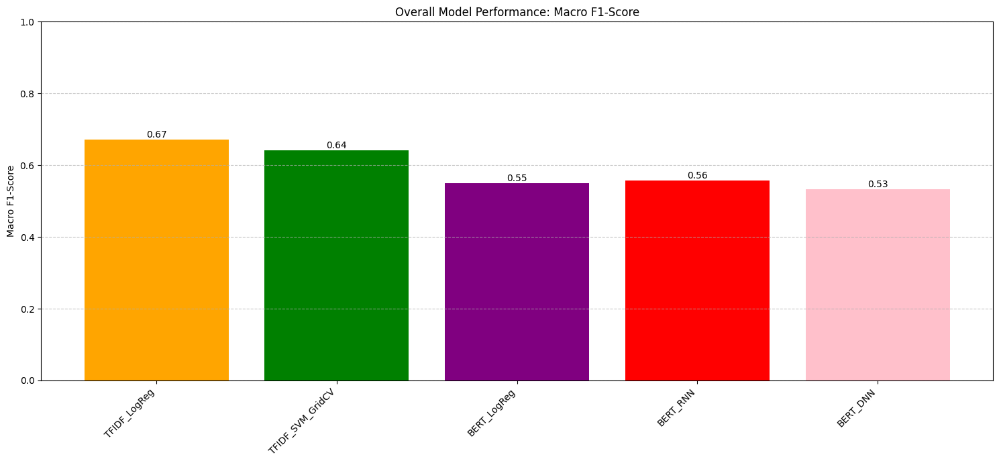

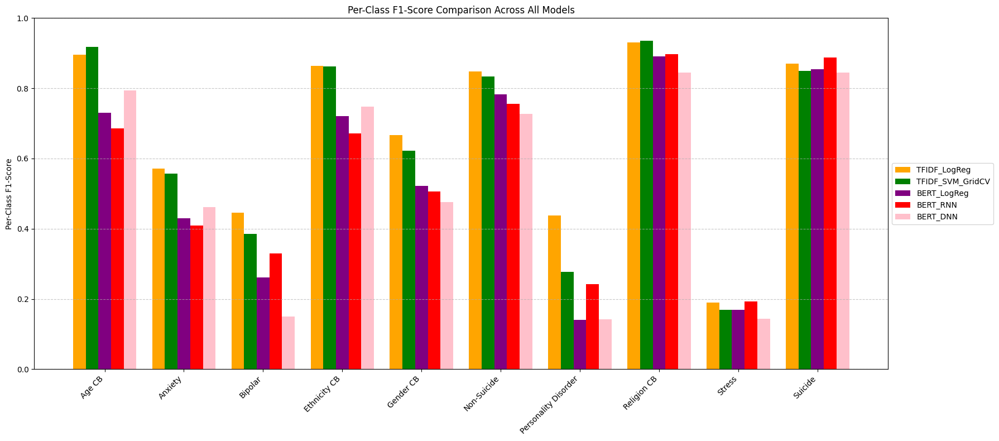

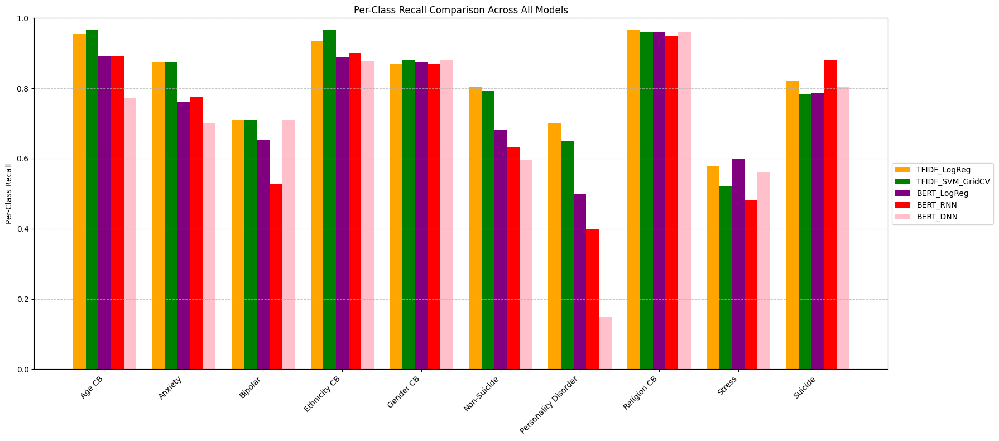

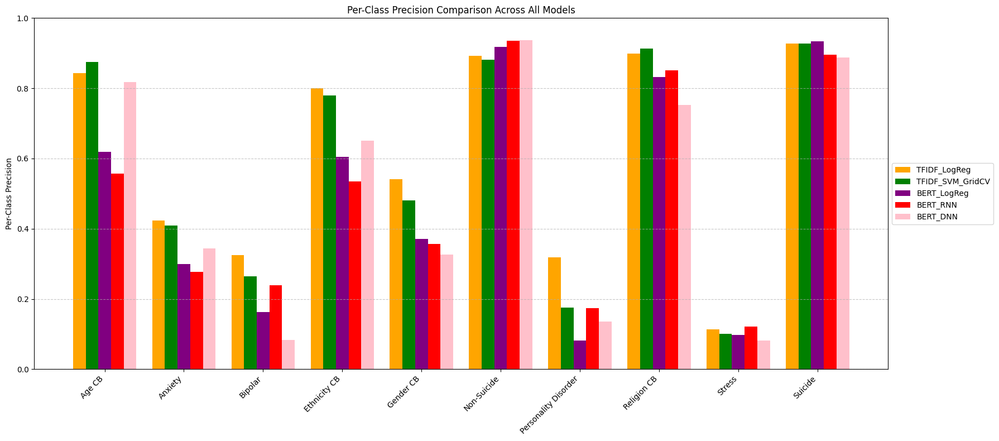

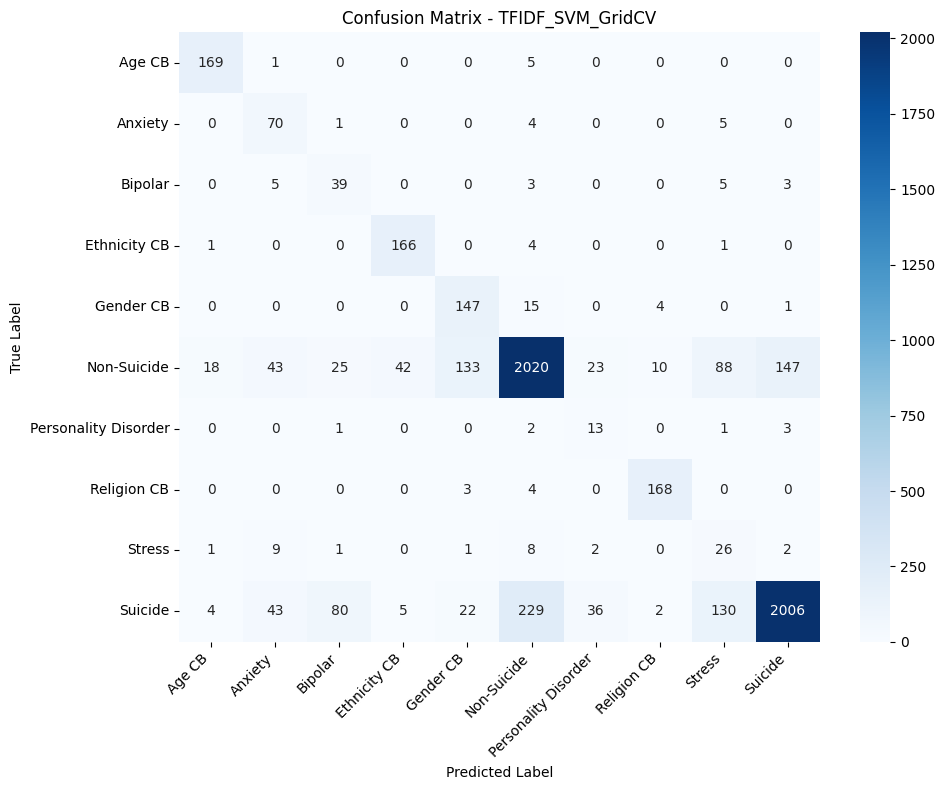

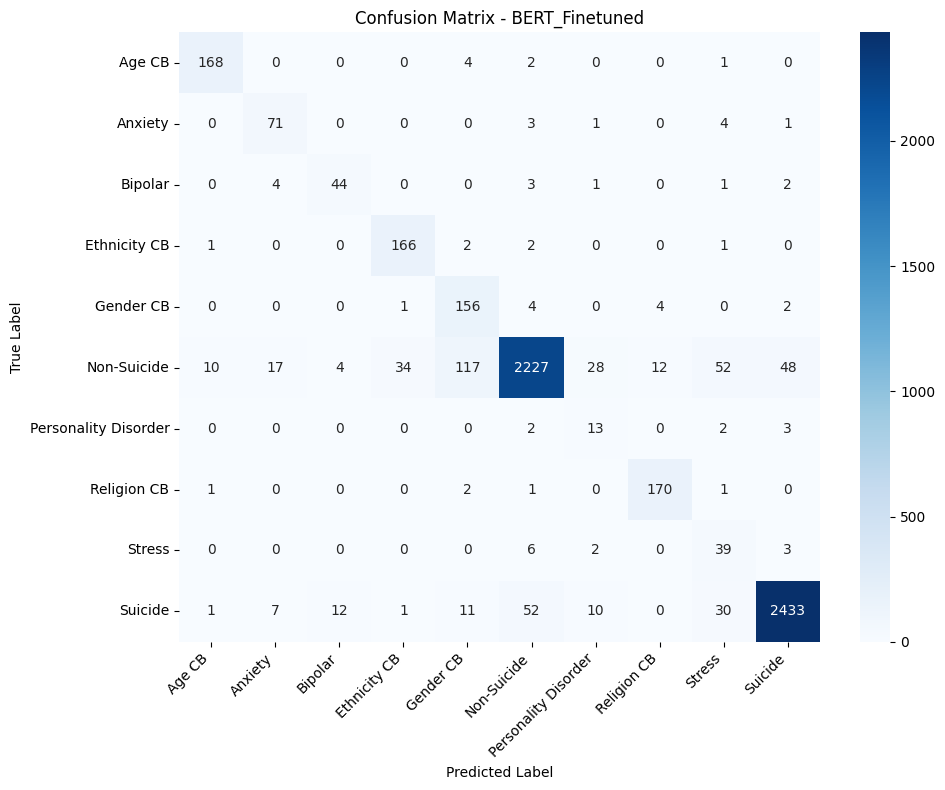

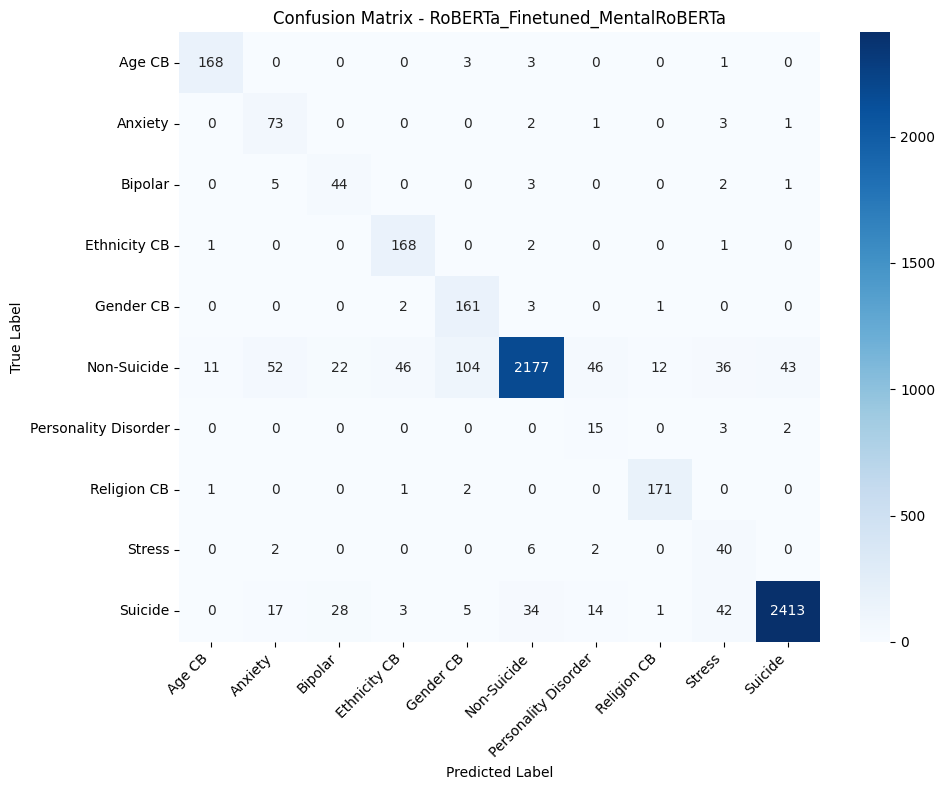

In [99]:
# ====================================================================================
# FINAL RESULTS PLOTTING (Corrected and Updated)
# ====================================================================================
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# --- Step 1: UPDATE the list of model names and colors ---
# These should be the exact keys from your 'model_results' dictionary.
model_names = [
    'TFIDF_LogReg',
    'TFIDF_SVM_GridCV',
    'BERT_LogReg',
    'BERT_RNN',
    'BERT_DNN',
    # 'BERT_Finetuned',
    # 'BERT_Finetuned_MentalBERT',
    # 'RoBERTa_Finetuned_MentalRoBERTa'
]

# This is the correctly ordered list of pretty names for your plot axes
# Assumes 'final_class_names_for_plotting' was created earlier
class_names = final_class_names_for_plotting 

# Define colors for all your models to prevent errors
colors = {
    'TFIDF_LogReg': 'orange',
    'TFIDF_SVM_GridCV': 'green',
    'BERT_LogReg': 'purple',
    'BERT_RNN': 'red',
    'BERT_DNN': 'pink',
    # 'BERT_Finetuned': 'blue',
    # 'BERT_Finetuned_MentalBERT': 'cyan',
    # 'RoBERTa_Finetuned_MentalRoBERTa': 'magenta'
}


# --- PLOT 1: Macro F1 Comparison Across Models ---
plt.figure(figsize=(15, 7))
# Filter to only include models that have been run
active_models = [m for m in model_names if m in model_results]
macro_f1_scores = [model_results[m]['macro_f1'] for m in active_models]

bars = plt.bar(active_models, macro_f1_scores, color=[colors[m] for m in active_models])
plt.ylabel("Macro F1-Score")
plt.title("Overall Model Performance: Macro F1-Score")
plt.xticks(rotation=45, ha='right')
plt.ylim(0, 1.0) # Set y-axis from 0 to 1 for consistent scale
plt.grid(axis='y', linestyle='--', alpha=0.7)
# Add labels on top of bars
plt.bar_label(bars, fmt='%.2f')
plt.tight_layout()
plt.show()


# --- PLOT 2: Per-Class F1-Score Comparison ---
plt.figure(figsize=(18, 8))
num_models = len(active_models)
num_classes = len(class_names)
x = np.arange(num_classes)
width = 0.8 / num_models # Dynamically calculate bar width

for i, model_name in enumerate(active_models):
    offset = width * i - (width * num_models / 2) + width / 2
    plt.bar(x + offset, model_results[model_name]['class_f1'], width=width,
            label=model_name, color=colors[model_name])

plt.ylabel("Per-Class F1-Score")
plt.title("Per-Class F1-Score Comparison Across All Models")
plt.xticks(x, class_names, rotation=45, ha='right')
plt.ylim(0, 1.0)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()


# ============================================================
# === FIX IS HERE: Correctly plotting per-class recall and precision ===
# ============================================================
# --- Per-Class RECALL plot ---
plt.figure(figsize=(18, 8))
for i, model_name in enumerate(active_models):
    offset = width * i - (width * num_models / 2) + width / 2
    # CORRECTED: Use 'class_recall' key
    plt.bar(x + offset, model_results[model_name]['class_recall'], width=width,
            label=model_name, color=colors[model_name])

plt.ylabel("Per-Class Recall")
plt.title("Per-Class Recall Comparison Across All Models")
plt.xticks(x, class_names, rotation=45, ha='right')
plt.ylim(0, 1.0)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()

# --- Per-Class PRECISION plot ---
plt.figure(figsize=(18, 8))
for i, model_name in enumerate(active_models):
    offset = width * i - (width * num_models / 2) + width / 2
    # CORRECTED: Use 'class_precision' key
    plt.bar(x + offset, model_results[model_name]['class_precision'], width=width,
            label=model_name, color=colors[model_name])

plt.ylabel("Per-Class Precision")
plt.title("Per-Class Precision Comparison Across All Models")
plt.xticks(x, class_names, rotation=45, ha='right')
plt.ylim(0, 1.0)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()
# ============================================================


# --- PLOT 3: Confusion Matrices for Key Models ---
# Plotting all 8 can be overwhelming. Let's plot the most important ones.
key_models = ['TFIDF_SVM_GridCV', 'BERT_Finetuned', 'RoBERTa_Finetuned_MentalRoBERTa']

for model_name in key_models:
    if model_name in model_results:
        plt.figure(figsize=(10, 8))
        sns.heatmap(model_results[model_name]['confusion'], annot=True, fmt="d", cmap="Blues",
                    xticklabels=class_names, yticklabels=class_names)
        plt.title(f"Confusion Matrix - {model_name}")
        plt.xlabel("Predicted Label")
        plt.ylabel("True Label")
        plt.xticks(rotation=45, ha='right')
        plt.yticks(rotation=0)
        plt.tight_layout()
        plt.show()

# Explainability - SHAP

### Using BERT-Finetuned model

Given the Finetuned BERT model is the best performing model, we used SHAP and LLAMA 3 70b using Langchain to understand the decision making for the model.

In [100]:
!pip install langchain-groq -q
# === Initialize Groq for LLM ===
# Make sure to set your GROQ_API_KEY environment variable
# from kaggle_secrets import UserSecretsClient
# user_secrets = UserSecretsClient()
# api_key = user_secrets.get_secret("GROQ_API_KEY")
api_key = os.getenv("GROQ_API_KEY")

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


## Explainabilty - Hybrid SHAP + LLM Explainer

In [101]:
# ====================================================================================
# FINAL, SELF-CONTAINED SCRIPT FOR HYBRID SHAP + LLM EXPLAINABILITY
# ====================================================================================
# --- Section 0: All Imports and Setup ---
import shap
import torch
import numpy as np
import pandas as pd
import random
import os
from transformers import pipeline, AutoTokenizer, AutoModelForSequenceClassification
from IPython.display import display, HTML

# Ensure necessary libraries are installed
try:
    from langchain_groq import ChatGroq
    from langchain.prompts import PromptTemplate
    from langchain.schema import HumanMessage
except ImportError:
    print("Installing langchain-groq...")
    !pip install langchain-groq -q
    from langchain_groq import ChatGroq
    from langchain.prompts import PromptTemplate
    from langchain.schema import HumanMessage

# IMPORTANT: SET YOUR API KEY HERE
# Replace "YOUR_GROQ_API_KEY" with your actual key, or load it from a secret manager.
from dotenv import load_dotenv
import os

load_dotenv()  # loads .env file
GROQ_API_KEY = os.getenv("GROQ_API_KEY")
groq_api_key = GROQ_API_KEY

if groq_api_key == "YOUR_GROQ_API_KEY":
    print("WARNING: Please replace 'YOUR_GROQ_API_KEY' with your actual Groq API key.")

# ==============================================================================
# === Section 1: Helper Functions and Global Initializations ===
# ==============================================================================
print("Defining helper functions for explainability...")

# --- Initialize SHAP for notebook display ---
shap.initjs()

# --- Initialize the LLM ---
llm = ChatGroq(model="openai/gpt-oss-20b", temperature=0.2, max_tokens=1500, groq_api_key=groq_api_key)

# --- YOUR PROMPT TEMPLATE (Unchanged) ---
hybrid_explanation_prompt = PromptTemplate(
    input_variables=["text", "predicted_label", "shap_words"],
    template="""
**Task:** Explain why a BERT model classified a text as '{predicted_label}'.

**Text:** "{text}"
**Key Predictive Words (from SHAP):** {shap_words}

**Instructions:**
Write a single, concise paragraph that provides a direct and analytical explanation.
- **Start directly** with the justification (e.g., "The model's classification is justified by...").
- **Integrate** the 'Key Predictive Words' into your analysis, explaining how they function within the context of the full text.
- **Focus** on the combination of explicit language and emotional tone.
- **Do not** use phrases like "The BERT model classified..." or "The Key Words identified...".
- **Maintain** a neutral, academic tone. Avoid clinical diagnoses.
"""
)

# ============================================================
# === THE DEFINITIVE FIX IS IN THIS FUNCTION ===
# ============================================================
def get_hybrid_llm_explanation(text, predicted_label, shap_value, top_n=7):
    """
    Generates a context-aware LLM explanation by combining the original text
    with the most influential words from a SHAP analysis.
    This version correctly handles the structure of the SHAP explanation object.
    """
    try:
        # 1. Find the numeric index of our predicted class
        class_index = list(shap_value.output_names).index(predicted_label)
        # 2. Get the raw token strings and their corresponding SHAP values for all classes
        words = shap_value.data
        all_values = shap_value.values
        # 3. Select the SHAP values for ONLY our predicted class
        values_for_predicted_class = all_values[:, class_index]
        # 4. Find the indices of the top N words that contributed positively
        top_indices = np.argsort(values_for_predicted_class)[-top_n:]
        # 5. Get the actual word strings for those top indices
        top_words = [words[i] for i in top_indices if values_for_predicted_class[i] > 0]
        if not top_words:
            return "No significant positive words were found by SHAP to explain this prediction."
        shap_words_str = ", ".join(reversed(top_words))
        # 6. Format the prompt and invoke the LLM
        prompt = hybrid_explanation_prompt.format(
            text=text, predicted_label=predicted_label, shap_words=shap_words_str
        )
        response = llm.invoke([HumanMessage(content=prompt)])
        return response.content.strip()
    except Exception as e:
        return f"Error in get_hybrid_llm_explanation: {str(e)}"
# ============================================================

# --- Function to display formatted explanation (Unchanged) ---
def display_llm_explanation(explanation):
    html_content = f"""
    <div style="border: 2px solid #4CAF50; border-radius: 10px; padding: 15px; margin: 10px 0; background-color: #f9f9f9;">
        <h3 style="color: #4CAF50; margin-top: 0;">🤖 LLM Explainability Analysis</h3>
        <div style="line-height: 1.6; white-space: pre-wrap; font-family: Arial, sans-serif;">{explanation}</div>
    </div>
    """
    display(HTML(html_content))

print("Helper functions are ready.")

# ==============================================================================
# === Section 2: Main Execution Block ===
# ==============================================================================

# --- Define which model you want to explain ---
MODEL_TO_EXPLAIN_DIR = "final_finetuned_mentalbert_model" 

# --- Load the fine-tuned model and its tokenizer ---
print(f"Loading fine-tuned model and tokenizer from '{MODEL_TO_EXPLAIN_DIR}'...")
device = 0 if torch.cuda.is_available() else -1
try:
    tokenizer = AutoTokenizer.from_pretrained(MODEL_TO_EXPLAIN_DIR)
    model = AutoModelForSequenceClassification.from_pretrained(MODEL_TO_EXPLAIN_DIR)
    model.eval().to(device)
    print("Model and tokenizer loaded successfully.")
except OSError:
    print(f"FATAL ERROR: Could not find the saved model in '{MODEL_TO_EXPLAIN_DIR}'.")
    raise

# --- THE ROBUST FIX: Re-create clean label maps from master_df ---
clean_label2id = {label: i for i, label in enumerate(final_train_df['status'].astype('category').cat.categories)}
clean_id2label = {v: k for k, v in clean_label2id.items()}
model.config.id2label = clean_id2label
model.config.label2id = clean_label2id
status_map = clean_id2label

# --- Create the SHAP explainer pipeline ---
pipe = pipeline("text-classification", model=model, tokenizer=tokenizer, top_k=None, device=device)
explainer = shap.Explainer(pipe)

# --- Select interesting samples from your FINAL TEST SET ('test_df') ---
df_for_explain = test_df.copy()
num_samples = 5
correct_suicide_samples = df_for_explain[df_for_explain['status'] == 'suicide'].sample(1, random_state=42)
correct_pd_samples = df_for_explain[df_for_explain['status'] == 'personality_disorder'].sample(1, random_state=42)
random_samples = df_for_explain.sample(num_samples - 2, random_state=42)
sampled_df = pd.concat([correct_suicide_samples, correct_pd_samples, random_samples]).reset_index(drop=True)
texts = sampled_df["text"].tolist()
true_labels_string = sampled_df["status"].tolist()

# --- Run the explanation loop ---
print("=" * 80)
print(f"HYBRID EXPLAINABILITY ANALYSIS for {MODEL_TO_EXPLAIN_DIR}")
print("=" * 80)

for i, text in enumerate(texts):
    # Get the inner list of prediction dictionaries
    predictions_list = pipe(text)[0]
    # Find the dictionary with the highest score
    top_pred = max(predictions_list, key=lambda d: d['score'])
    predicted_label_str = top_pred['label']
    confidence = top_pred["score"]

    print(f"\\n📄 **TEXT {i+1}**: \\\"{text[:150]}{'...' if len(text) > 150 else ''}\\\"")
    print(f"🎯 Actual Label: {true_labels_string[i]}")
    print(f"🤖 Predicted: {predicted_label_str}  |  Confidence: {confidence:.3f}")
    print("-" * 60)

    print("🔍 SHAP Token-level Explanation:")
    shap_values = explainer([text])
    
    # SHAP will now use the correct labels from the model's config
    shap.plots.text(shap_values, display=True)

    print("\\n🧠 Getting Hybrid LLM Explanation (from Text + SHAP data)...")
    llm_explanation = get_hybrid_llm_explanation(
        text=text,
        predicted_label=predicted_label_str,
        shap_value=shap_values[0]
    )
    display_llm_explanation(llm_explanation)

    print("\\n" + "="*80)

Defining helper functions for explainability...


Helper functions are ready.
Loading fine-tuned model and tokenizer from 'final_finetuned_mentalbert_model'...


Device set to use cuda:0


Model and tokenizer loaded successfully.
HYBRID EXPLAINABILITY ANALYSIS for final_finetuned_mentalbert_model
\n📄 **TEXT 1**: \"gonna fucking hang myselfwhy doesnt any want to fucking be with me i hate myself i always fucking try the best i can and try too hard but it never fuc...\"
🎯 Actual Label: suicide
🤖 Predicted: suicide  |  Confidence: 0.996
------------------------------------------------------------
🔍 SHAP Token-level Explanation:


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
PartitionExplainer explainer: 2it [00:10, 10.30s/it]                                                                                                                                       


\n🧠 Getting Hybrid LLM Explanation (from Text + SHAP data)...


\n================================================================================
\n📄 **TEXT 2**: \"does anyone write stories does anyone here write stories with characters is it tough in my experience i feel like i dont know enough about people to w...\"
🎯 Actual Label: personality_disorder
🤖 Predicted: non_suicide  |  Confidence: 0.444
------------------------------------------------------------
🔍 SHAP Token-level Explanation:


\n🧠 Getting Hybrid LLM Explanation (from Text + SHAP data)...


\n================================================================================
\n📄 **TEXT 3**: \"i might do itthis would be the best time considering i lost my closest friends and i have very few people that care about me\"
🎯 Actual Label: suicide
🤖 Predicted: suicide  |  Confidence: 0.996
------------------------------------------------------------
🔍 SHAP Token-level Explanation:


\n🧠 Getting Hybrid LLM Explanation (from Text + SHAP data)...


\n================================================================================
\n📄 **TEXT 4**: \"well im tryingmy father left my house long time ago he tried to harm my mom so she left him im proud of her i had a stepfather and he left us to im no...\"
🎯 Actual Label: suicide
🤖 Predicted: suicide  |  Confidence: 0.996
------------------------------------------------------------
🔍 SHAP Token-level Explanation:


  0%|          | 0/498 [00:00<?, ?it/s]

\n🧠 Getting Hybrid LLM Explanation (from Text + SHAP data)...


\n================================================================================
\n📄 **TEXT 5**: \"i try so fucking hard what the fuck brain you dumb ass kill me yourselfyou stupid piece of shit too dumb to hold knowledge and shit but you can tell m...\"
🎯 Actual Label: suicide
🤖 Predicted: suicide  |  Confidence: 0.982
------------------------------------------------------------
🔍 SHAP Token-level Explanation:


\n🧠 Getting Hybrid LLM Explanation (from Text + SHAP data)...


\n================================================================================
